<a href="https://colab.research.google.com/github/jalevano/tfm_uoc_datascience/blob/main/01_Mask2Former_Mascaras_Visor.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
# -*- coding: utf-8 -*-
"""
02_Mask2Former_Analisis_Completo_v2.1.ipynb
============================================

Sistema Completo de Análisis para Resultados Mask2Former
con Máscaras Separadas en NPZ

Características:
- Auto-descubrimiento de todos los resultados
- Análisis estadístico global con gráficas
- Análisis geométrico Shapely desde NPZ
- Análisis de máscaras raw desde NPZ
- Comparación cuantitativa entre modelos
- Exportación de resultados para TFM

Autor: Jesús L.
Proyecto: TFM - Universidad Oberta de Cataluña
Fecha: 2025
"""

'\n02_Mask2Former_Analisis_Completo_v2.1.ipynb\n============================================\n\nSistema Completo de Análisis para Resultados Mask2Former\ncon Máscaras Separadas en NPZ\n\nCaracterísticas:\n- Auto-descubrimiento de todos los resultados\n- Análisis estadístico global con gráficas\n- Análisis geométrico Shapely desde NPZ\n- Análisis de máscaras raw desde NPZ\n- Comparación cuantitativa entre modelos\n- Exportación de resultados para TFM\n\nAutor: Jesús L.\nProyecto: TFM - Universidad Oberta de Cataluña\nFecha: 2025\n'

In [2]:
# =============================================================================
# SETUP Y CONFIGURACIÓN
# =============================================================================

print("="*80)
print("SETUP: Instalando dependencias y configurando entorno")
print("="*80)

# Instalar dependencias si es necesario

!pip install -q plotly
!pip install -q kaleido
!pip install -q pandas
!pip install -q seaborn
!pip install -q shapely

SETUP: Instalando dependencias y configurando entorno
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.3/66.3 kB 3.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 52.3/52.3 kB 3.2 MB/s eta 0:00:00


In [3]:
# Imports
import json
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots
from pathlib import Path
from typing import Dict, List, Any, Optional, Tuple
from dataclasses import dataclass
from datetime import datetime
from collections import defaultdict
import warnings

# Shapely para geometría
from shapely import wkt
from shapely.geometry import Polygon
from matplotlib.patches import Polygon as MplPolygon

# PIL para imágenes
from PIL import Image, ImageDraw

# Configuración de visualización
warnings.filterwarnings('ignore')
plt.style.use('seaborn-v0_8-darkgrid')
sns.set_palette("husl")

# Configuración de pandas
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', 100)
pd.set_option('display.width', None)
pd.set_option('display.float_format', lambda x: f'{x:.3f}')

print("✅ Imports completados\n")

# =============================================================================
# MONTAR GOOGLE DRIVE
# =============================================================================

try:
    from google.colab import drive
    drive.mount('/content/drive', force_remount=False)
    IN_COLAB = True
    print("✅ Google Drive montado\n")
except:
    IN_COLAB = False
    print("⚠️ No estamos en Colab, continuando sin Drive...\n")

✅ Imports completados

Mounted at /content/drive
✅ Google Drive montado



In [4]:
# =============================================================================
# CONFIGURACIÓN DE RUTAS
# =============================================================================

@dataclass
class ConfigAnalisis:
    """Configuración centralizada para el análisis"""

    # Ruta base de resultados
    BASE_RESULTADOS: Path = Path("/content/drive/MyDrive/TFM/mask2former/resultados")

    # Ruta de dataset (para imágenes originales)
    DATASET_PATH: Path = Path("/content/drive/MyDrive/TFM/mask2former/imagenes")

    # Directorio de salida para exportaciones
    OUTPUT_PATH: Path = Path("/content/drive/MyDrive/TFM/mask2former/analisis_exports")

    # Configuración de visualización
    FIGSIZE_GRANDE: Tuple[int, int] = (20, 12)
    FIGSIZE_MEDIANO: Tuple[int, int] = (15, 8)
    FIGSIZE_PEQUEÑO: Tuple[int, int] = (12, 6)
    DPI: int = 150

    # Configuración de gráficas interactivas
    USAR_PLOTLY: bool = True
    GUARDAR_HTML: bool = True

    # Configuración de exportación
    EXPORTAR_CSV: bool = True
    EXPORTAR_EXCEL: bool = True
    EXPORTAR_LATEX: bool = True

    def __post_init__(self):
        # Crear directorio de salida si no existe
        self.OUTPUT_PATH.mkdir(parents=True, exist_ok=True)

        # Crear subdirectorios
        (self.OUTPUT_PATH / "graficas").mkdir(exist_ok=True)
        (self.OUTPUT_PATH / "tablas").mkdir(exist_ok=True)
        (self.OUTPUT_PATH / "html_interactivo").mkdir(exist_ok=True)

# Inicializar configuración
config = ConfigAnalisis()

print("="*80)
print("CONFIGURACIÓN")
print("="*80)
print(f"Base resultados: {config.BASE_RESULTADOS}")
print(f"Dataset: {config.DATASET_PATH}")
print(f"Output: {config.OUTPUT_PATH}")
print(f"Gráficas interactivas (Plotly): {'✓' if config.USAR_PLOTLY else '✗'}")
print(f"Exportar CSV: {'✓' if config.EXPORTAR_CSV else '✗'}")
print(f"Exportar Excel: {'✓' if config.EXPORTAR_EXCEL else '✗'}")
print(f"Exportar LaTeX: {'✓' if config.EXPORTAR_LATEX else '✗'}")
print("="*80 + "\n")

CONFIGURACIÓN
Base resultados: /content/drive/MyDrive/TFM/mask2former/resultados
Dataset: /content/drive/MyDrive/TFM/mask2former/imagenes
Output: /content/drive/MyDrive/TFM/mask2former/analisis_exports
Gráficas interactivas (Plotly): ✓
Exportar CSV: ✓
Exportar Excel: ✓
Exportar LaTeX: ✓



In [5]:
# =============================================================================
# CLASES Y FUNCIONES AUXILIARES
# =============================================================================

class GestorMascaras:
    """Gestor para cargar máscaras desde archivos NPZ"""

    def __init__(self, directorio_base: Path):
        self.directorio_base = directorio_base
        self.directorio_mascaras = directorio_base / "mascaras_raw"

        if not self.directorio_mascaras.exists():
            print(f"⚠️ Directorio de máscaras no encontrado: {self.directorio_mascaras}")

    def cargar_mascaras_imagen(self, ruta_relativa: str) -> Optional[Dict[str, Any]]:
        """Carga máscaras desde archivo NPZ"""
        try:
            archivo_path = self.directorio_base / ruta_relativa

            if not archivo_path.exists():
                print(f"⚠️ Archivo de máscaras no encontrado: {archivo_path}")
                return None

            # Cargar datos
            data = np.load(archivo_path, allow_pickle=True)

            resultado = {
                'metadatos': data['metadatos'].item(),
                'mascaras_por_umbral': {}
            }

            # Reconstruir estructura por umbral
            for key in data.files:
                if key.startswith('umbral_') and key != 'metadatos':
                    parts = key.split('_')
                    if len(parts) >= 2:
                        umbral_key = f"{parts[0]}_{parts[1]}"

                        if umbral_key not in resultado['mascaras_por_umbral']:
                            resultado['mascaras_por_umbral'][umbral_key] = []

                        resultado['mascaras_por_umbral'][umbral_key].append(data[key])

            return resultado

        except Exception as e:
            print(f"❌ Error cargando máscaras desde {ruta_relativa}: {str(e)}")
            return None

    def obtener_estadisticas_almacenamiento(self) -> Dict[str, Any]:
        """Obtiene estadísticas de los archivos de máscaras"""
        if not self.directorio_mascaras.exists():
            return {
                'total_archivos': 0,
                'tamaño_total_mb': 0,
                'tamaño_promedio_mb': 0
            }

        archivos_npz = list(self.directorio_mascaras.glob("*.npz"))

        if not archivos_npz:
            return {
                'total_archivos': 0,
                'tamaño_total_mb': 0,
                'tamaño_promedio_mb': 0
            }

        tamaños = [f.stat().st_size for f in archivos_npz]
        tamaño_total = sum(tamaños)

        return {
            'total_archivos': len(archivos_npz),
            'tamaño_total_mb': round(tamaño_total / (1024**2), 2),
            'tamaño_promedio_mb': round(np.mean(tamaños) / (1024**2), 2),
            'tamaño_min_mb': round(min(tamaños) / (1024**2), 2),
            'tamaño_max_mb': round(max(tamaños) / (1024**2), 2)
        }

class ExploradorResultados:
    """Explorador automático de resultados"""

    def __init__(self, base_path: Path):
        self.base_path = base_path
        self.ejecuciones = []
        self.resultados_json = []

    def escanear_directorio(self) -> Dict[str, Any]:
        """Escanea el directorio base y encuentra todos los resultados"""
        print("🔍 Escaneando directorio de resultados...\n")

        if not self.base_path.exists():
            print(f"❌ Directorio no existe: {self.base_path}")
            return {}

        # Encontrar todas las ejecuciones
        self.ejecuciones = sorted([d for d in self.base_path.iterdir() if d.is_dir() and d.name.startswith('ejecucion_')])

        print(f"✅ Ejecuciones encontradas: {len(self.ejecuciones)}")

        # Explorar cada ejecución
        estructura = {}

        for ejecucion in self.ejecuciones:
            print(f"\n📁 {ejecucion.name}")

            # Encontrar subdirectorios de modelos
            modelos_dirs = [d for d in ejecucion.iterdir()
                          if d.is_dir() and d.name not in ['logs', 'visualizaciones', 'formato_coco', 'mascaras_raw']]

            estructura[ejecucion.name] = {
                'path': ejecucion,
                'modelos': {},
                'mascaras_raw': ejecucion / 'mascaras_raw',
                'visualizaciones': ejecucion / 'visualizaciones',
                'formato_coco': ejecucion / 'formato_coco'
            }

            for modelo_dir in modelos_dirs:
                print(f"  🤖 {modelo_dir.name}/")

                # Encontrar archivos JSON
                archivos_json = list(modelo_dir.glob("*.json"))

                estructura[ejecucion.name]['modelos'][modelo_dir.name] = {
                    'path': modelo_dir,
                    'archivos_json': archivos_json,
                    'num_archivos': len(archivos_json)
                }

                # Listar archivos
                for archivo in archivos_json:
                    tamaño_mb = archivo.stat().st_size / (1024**2)
                    print(f"      📄 {archivo.name} ({tamaño_mb:.2f} MB)")

                    self.resultados_json.append({
                        'ejecucion': ejecucion.name,
                        'modelo': modelo_dir.name,
                        'archivo': archivo.name,
                        'path': archivo,
                        'tamaño_mb': tamaño_mb
                    })

            # Estadísticas de máscaras
            gestor_mascaras = GestorMascaras(ejecucion)
            stats_mascaras = gestor_mascaras.obtener_estadisticas_almacenamiento()

            if stats_mascaras['total_archivos'] > 0:
                print(f"\n  💾 Máscaras NPZ:")
                print(f"      Total: {stats_mascaras['total_archivos']} archivos")
                print(f"      Tamaño total: {stats_mascaras['tamaño_total_mb']} MB")
                print(f"      Promedio: {stats_mascaras['tamaño_promedio_mb']} MB/archivo")

        return estructura

class CargadorResultados:
    """Cargador eficiente de resultados JSON"""

    def __init__(self, config: ConfigAnalisis):
        self.config = config
        self.cache_json = {}

    def cargar_json(self, path: Path, usar_cache: bool = True) -> Optional[Dict[str, Any]]:
        """Carga un archivo JSON con opción de caché"""
        path_str = str(path)

        if usar_cache and path_str in self.cache_json:
            return self.cache_json[path_str]

        try:
            with open(path, 'r', encoding='utf-8') as f:
                datos = json.load(f)

            if usar_cache:
                self.cache_json[path_str] = datos

            return datos

        except Exception as e:
            print(f"❌ Error cargando {path.name}: {str(e)}")
            return None

    def cargar_todos_resultados(self, lista_archivos: List[Dict]) -> List[Dict[str, Any]]:
        """Carga todos los resultados JSON"""
        resultados = []

        print(f"\n📦 Cargando {len(lista_archivos)} archivos JSON...")

        from tqdm import tqdm
        for info_archivo in tqdm(lista_archivos):
            datos = self.cargar_json(info_archivo['path'])

            if datos:
                resultados.append({
                    'info_archivo': info_archivo,
                    'datos': datos,
                    'metadatos': datos.get('metadatos_archivo', {}),
                    'resumen': datos.get('resumen_estadistico', {}),
                    'resultados_detallados': datos.get('resultados_detallados', [])
                })

        print(f"✅ Cargados {len(resultados)} resultados exitosamente\n")
        return resultados

def calcular_metricas_comparativas(mascara1: np.ndarray, mascara2: np.ndarray) -> Dict[str, float]:
    """Calcula métricas de comparación entre dos máscaras"""
    # Binarizar máscaras
    m1 = (mascara1 > 0.5).astype(np.float32)
    m2 = (mascara2 > 0.5).astype(np.float32)

    # Intersección y unión
    intersection = np.logical_and(m1, m2).sum()
    union = np.logical_or(m1, m2).sum()

    # IoU (Intersection over Union)
    iou = intersection / union if union > 0 else 0.0

    # Dice coefficient
    dice = (2 * intersection) / (m1.sum() + m2.sum()) if (m1.sum() + m2.sum()) > 0 else 0.0

    # Precisión y Recall (usando m1 como ground truth)
    true_positive = intersection
    false_positive = np.logical_and(m2, np.logical_not(m1)).sum()
    false_negative = np.logical_and(m1, np.logical_not(m2)).sum()

    precision = true_positive / (true_positive + false_positive) if (true_positive + false_positive) > 0 else 0.0
    recall = true_positive / (true_positive + false_negative) if (true_positive + false_negative) > 0 else 0.0

    # F1-score
    f1 = 2 * (precision * recall) / (precision + recall) if (precision + recall) > 0 else 0.0

    return {
        'iou': float(iou),
        'dice': float(dice),
        'precision': float(precision),
        'recall': float(recall),
        'f1_score': float(f1)
    }

In [7]:
# =============================================================================
# ANÁLISIS ESTADÍSTICO GLOBAL
# =============================================================================

print("\n" + "="*80)
print("CELDA 1: ANÁLISIS ESTADÍSTICO GLOBAL")
print("="*80 + "\n")

# Explorar directorio
explorador = ExploradorResultados(config.BASE_RESULTADOS)
estructura = explorador.escanear_directorio()

# Cargar todos los resultados
cargador = CargadorResultados(config)
todos_resultados = cargador.cargar_todos_resultados(explorador.resultados_json)

if not todos_resultados:
    print("❌ No se encontraron resultados para analizar")
else:
    print(f"\n✅ Total de resultados cargados: {len(todos_resultados)}")

# =============================================================================
# TABLA COMPARATIVA DE MODELOS
# =============================================================================

print("\n" + "-"*80)
print("1.1 TABLA COMPARATIVA DE MODELOS")
print("-"*80 + "\n")

# Construir DataFrame comparativo
datos_comparativos = []

for resultado in todos_resultados:
    metadatos = resultado['metadatos']
    resumen = resultado['resumen']
    info = resultado['info_archivo']

    # Extraer información del modelo
    modelo_eval = metadatos.get('modelo_evaluado', {})
    config_umbral = metadatos.get('configuracion_umbrales', {})

    # Estadísticas de rendimiento
    stats_rendimiento = resumen.get('estadisticas_rendimiento', {})
    tiempo_inf = stats_rendimiento.get('tiempo_inferencia', {})
    memoria = stats_rendimiento.get('memoria', {})

    # Estadísticas de detección (primer umbral como referencia)
    stats_deteccion = resumen.get('estadisticas_deteccion', {})
    if stats_deteccion:
        primer_umbral_key = list(stats_deteccion.keys())[0]
        stats_primer_umbral = stats_deteccion[primer_umbral_key]
    else:
        stats_primer_umbral = {}

    # Estadísticas Shapely
    stats_shapely = resumen.get('estadisticas_mascaras_shapely', {})

    datos_comparativos.append({
        # Identificación
        'Ejecución': info['ejecucion'],
        'Modelo': modelo_eval.get('nombre_corto', 'N/A'),
        'Tipo': modelo_eval.get('tipo', 'N/A'),
        'Dataset': modelo_eval.get('dataset', 'N/A'),
        'Arquitectura': modelo_eval.get('arquitectura', 'N/A'),
        'Config_Umbral': config_umbral.get('nombre', 'N/A'),

        # Procesamiento
        'Total_Imágenes': metadatos.get('total_imagenes_procesadas', 0),
        'Imágenes_Exitosas': resumen.get('metadatos_resumen', {}).get('imagenes_exitosas', 0),
        'Tasa_Éxito_%': resumen.get('metadatos_resumen', {}).get('tasa_exito', 0) * 100,

        # Rendimiento
        'Tiempo_Promedio_ms': tiempo_inf.get('promedio_ms', 0),
        'Tiempo_Min_ms': tiempo_inf.get('minimo_ms', 0),
        'Tiempo_Max_ms': tiempo_inf.get('maximo_ms', 0),
        'Tiempo_Std_ms': tiempo_inf.get('desviacion_std', 0),
        'Memoria_Promedio_MB': memoria.get('promedio_mb', 0),
        'Memoria_Max_MB': memoria.get('maxima_mb', 0),

        # Detección (primer umbral)
        'Total_Personas': stats_primer_umbral.get('total_personas_detectadas', 0),
        'Imágenes_Con_Personas': stats_primer_umbral.get('imagenes_con_personas', 0),
        '% Imágenes_Con_Personas': stats_primer_umbral.get('porcentaje_imagenes_con_personas', 0),
        'Personas_Promedio': stats_primer_umbral.get('personas_promedio_por_imagen', 0),
        'Score_Promedio': stats_primer_umbral.get('score_promedio', 0),

        # Shapely
        'Máscaras_Analizadas': stats_shapely.get('total_mascaras_analizadas', 0),
        'Máscaras_Válidas': stats_shapely.get('mascaras_shapely_validas', 0),
        'Tasa_Validez_Shapely_%': stats_shapely.get('tasa_validez_shapely', 0) * 100,
        'Compacidad_Media': stats_shapely.get('compactness_estadisticas', {}).get('mean', 0),
        'Convexidad_Media': stats_shapely.get('convexity_ratio_estadisticas', {}).get('mean', 0),

        # Metadatos archivo
        'Tamaño_JSON_MB': info['tamaño_mb'],
        'Framework_Version': metadatos.get('version_framework', 'N/A')
    })

df_comparativo = pd.DataFrame(datos_comparativos)

# Mostrar tabla
print("📊 TABLA COMPARATIVA COMPLETA")
print(df_comparativo.to_string(index=False))

# Exportar tabla
if config.EXPORTAR_CSV:
    csv_path = config.OUTPUT_PATH / "tablas" / f"comparativa_modelos_{datetime.now().strftime('%Y%m%d_%H%M%S')}.csv"
    df_comparativo.to_csv(csv_path, index=False)
    print(f"\n✅ Tabla exportada a CSV: {csv_path}")

if config.EXPORTAR_EXCEL:
    excel_path = config.OUTPUT_PATH / "tablas" / f"comparativa_modelos_{datetime.now().strftime('%Y%m%d_%H%M%S')}.xlsx"
    df_comparativo.to_excel(excel_path, index=False, engine='openpyxl')
    print(f"✅ Tabla exportada a Excel: {excel_path}")

if config.EXPORTAR_LATEX:
    latex_path = config.OUTPUT_PATH / "tablas" / f"comparativa_modelos_{datetime.now().strftime('%Y%m%d_%H%M%S')}.tex"
    latex_str = df_comparativo.to_latex(index=False, float_format="%.3f")
    with open(latex_path, 'w', encoding='utf-8') as f:
        f.write(latex_str)
    print(f"✅ Tabla exportada a LaTeX: {latex_path}")


CELDA 1: ANÁLISIS ESTADÍSTICO GLOBAL

🔍 Escaneando directorio de resultados...

✅ Ejecuciones encontradas: 1

📁 ejecucion_20251004_171557
  🤖 m551_inst_coco/
      📄 m551_inst_coco_cfg_ultr_20251004_172106.json (0.11 MB)
      📄 m551_inst_coco_cfg_alta_20251004_172555.json (0.12 MB)
      📄 m551_inst_coco_cfg_sens_20251004_173036.json (0.11 MB)
      📄 m551_inst_coco_cfg_baja_20251004_173453.json (0.11 MB)
  🤖 m378_sema_ade2/
      📄 m378_sema_ade2_cfg_ultr_20251004_173914.json (0.25 MB)
      📄 m378_sema_ade2_cfg_alta_20251004_174259.json (0.27 MB)
      📄 m378_sema_ade2_cfg_sens_20251004_174647.json (0.21 MB)
      📄 m378_sema_ade2_cfg_baja_20251004_175028.json (0.13 MB)
  🤖 m249_inst_coco/
      📄 m249_inst_coco_cfg_ultr_20251004_175425.json (0.11 MB)
      📄 m249_inst_coco_cfg_alta_20251004_175817.json (0.12 MB)
      📄 m249_inst_coco_cfg_sens_20251004_180154.json (0.11 MB)
      📄 m249_inst_coco_cfg_baja_20251004_180522.json (0.11 MB)

  💾 Máscaras NPZ:
      Total: 29 archivos
 

100%|██████████| 12/12 [00:00<00:00, 151.24it/s]

✅ Cargados 12 resultados exitosamente


✅ Total de resultados cargados: 12

--------------------------------------------------------------------------------
1.1 TABLA COMPARATIVA DE MODELOS
--------------------------------------------------------------------------------

📊 TABLA COMPARATIVA COMPLETA
                Ejecución                   Modelo      Tipo Dataset Arquitectura      Config_Umbral  Total_Imágenes  Imágenes_Exitosas  Tasa_Éxito_%  Tiempo_Promedio_ms  Tiempo_Min_ms  Tiempo_Max_ms  Tiempo_Std_ms  Memoria_Promedio_MB  Memoria_Max_MB  Total_Personas  Imágenes_Con_Personas  % Imágenes_Con_Personas  Personas_Promedio  Score_Promedio  Máscaras_Analizadas  Máscaras_Válidas  Tasa_Validez_Shapely_%  Compacidad_Media  Convexidad_Media  Tamaño_JSON_MB      Framework_Version
ejecucion_20251004_171557 swin-large-coco-instance instancia    COCO   Swin-Large     ultra_sensible               8                  8       100.000            8639.335       7720.369      10192.502        661

In [8]:
# =============================================================================
# 1.2 GRÁFICAS DE RENDIMIENTO
# =============================================================================

print("\n" + "-"*80)
print("1.2 GRÁFICAS DE RENDIMIENTO")
print("-"*80 + "\n")

# Gráfica 1: Tiempo de Inferencia por Modelo
if config.USAR_PLOTLY:
    fig = go.Figure()

    for modelo in df_comparativo['Modelo'].unique():
        df_modelo = df_comparativo[df_comparativo['Modelo'] == modelo]

        fig.add_trace(go.Bar(
            name=modelo,
            x=df_modelo['Config_Umbral'],
            y=df_modelo['Tiempo_Promedio_ms'],
            error_y=dict(type='data', array=df_modelo['Tiempo_Std_ms']),
            text=df_modelo['Tiempo_Promedio_ms'].round(2),
            textposition='auto',
        ))

    fig.update_layout(
        title='Tiempo de Inferencia Promedio por Modelo y Configuración',
        xaxis_title='Configuración de Umbral',
        yaxis_title='Tiempo (ms)',
        barmode='group',
        template='plotly_white',
        height=600,
        width=1200
    )

    fig.show()

    if config.GUARDAR_HTML:
        html_path = config.OUTPUT_PATH / "html_interactivo" / "tiempo_inferencia.html"
        fig.write_html(html_path)
        print(f"✅ Gráfica interactiva guardada: {html_path}")

else:
    # Versión matplotlib
    fig, ax = plt.subplots(figsize=config.FIGSIZE_MEDIANO, dpi=config.DPI)

    modelos = df_comparativo['Modelo'].unique()
    x = np.arange(len(df_comparativo['Config_Umbral'].unique()))
    width = 0.8 / len(modelos)

    for i, modelo in enumerate(modelos):
        df_modelo = df_comparativo[df_comparativo['Modelo'] == modelo]
        ax.bar(x + i * width, df_modelo['Tiempo_Promedio_ms'], width,
               label=modelo, yerr=df_modelo['Tiempo_Std_ms'])

    ax.set_xlabel('Configuración de Umbral')
    ax.set_ylabel('Tiempo (ms)')
    ax.set_title('Tiempo de Inferencia Promedio por Modelo')
    ax.set_xticks(x + width * (len(modelos) - 1) / 2)
    ax.set_xticklabels(df_comparativo['Config_Umbral'].unique(), rotation=45)
    ax.legend()
    ax.grid(True, alpha=0.3)
    plt.tight_layout()
    plt.show()

# Gráfica 2: Uso de Memoria
if config.USAR_PLOTLY:
    fig = go.Figure()

    for modelo in df_comparativo['Modelo'].unique():
        df_modelo = df_comparativo[df_comparativo['Modelo'] == modelo]

        fig.add_trace(go.Scatter(
            name=modelo,
            x=df_modelo['Config_Umbral'],
            y=df_modelo['Memoria_Promedio_MB'],
            mode='lines+markers',
            line=dict(width=3),
            marker=dict(size=10)
        ))

    fig.update_layout(
        title='Uso de Memoria por Modelo y Configuración',
        xaxis_title='Configuración de Umbral',
        yaxis_title='Memoria (MB)',
        template='plotly_white',
        height=600,
        width=1200
    )

    fig.show()

    if config.GUARDAR_HTML:
        html_path = config.OUTPUT_PATH / "html_interactivo" / "uso_memoria.html"
        fig.write_html(html_path)
        print(f"✅ Gráfica interactiva guardada: {html_path}")


--------------------------------------------------------------------------------
1.2 GRÁFICAS DE RENDIMIENTO
--------------------------------------------------------------------------------



✅ Gráfica interactiva guardada: /content/drive/MyDrive/TFM/mask2former/analisis_exports/html_interactivo/tiempo_inferencia.html


✅ Gráfica interactiva guardada: /content/drive/MyDrive/TFM/mask2former/analisis_exports/html_interactivo/uso_memoria.html


In [9]:
# =============================================================================
# 1.3 GRÁFICAS DE DETECCIÓN
# =============================================================================

print("\n" + "-"*80)
print("1.3 GRÁFICAS DE DETECCIÓN")
print("-"*80 + "\n")

# Gráfica 3: Personas Detectadas por Umbral
# Necesitamos datos de todos los umbrales, no solo el primero

datos_por_umbral = []

for resultado in todos_resultados:
    metadatos = resultado['metadatos']
    resumen = resultado['resumen']
    info = resultado['info_archivo']

    modelo_eval = metadatos.get('modelo_evaluado', {})
    stats_deteccion = resumen.get('estadisticas_deteccion', {})

    for umbral_key, stats in stats_deteccion.items():
        umbral_val = umbral_key.replace('umbral_', '')

        datos_por_umbral.append({
            'Modelo': modelo_eval.get('nombre_corto', 'N/A'),
            'Umbral': float(umbral_val),
            'Total_Personas': stats.get('total_personas_detectadas', 0),
            'Imágenes_Con_Personas': stats.get('imagenes_con_personas', 0),
            '% Detección': stats.get('porcentaje_imagenes_con_personas', 0),
            'Score_Promedio': stats.get('score_promedio', 0)
        })

df_umbrales = pd.DataFrame(datos_por_umbral)

if config.USAR_PLOTLY:
    fig = make_subplots(
        rows=2, cols=2,
        subplot_titles=('Total Personas Detectadas', '% Imágenes con Detección',
                       'Score Promedio de Confianza', 'Imágenes con Personas'),
        specs=[[{'type': 'scatter'}, {'type': 'scatter'}],
               [{'type': 'scatter'}, {'type': 'bar'}]]
    )

    for modelo in df_umbrales['Modelo'].unique():
        df_modelo = df_umbrales[df_umbrales['Modelo'] == modelo]

        # Subplot 1: Total personas
        fig.add_trace(
            go.Scatter(x=df_modelo['Umbral'], y=df_modelo['Total_Personas'],
                      mode='lines+markers', name=modelo, showlegend=True),
            row=1, col=1
        )

        # Subplot 2: % Detección
        fig.add_trace(
            go.Scatter(x=df_modelo['Umbral'], y=df_modelo['% Detección'],
                      mode='lines+markers', name=modelo, showlegend=False),
            row=1, col=2
        )

        # Subplot 3: Score promedio
        fig.add_trace(
            go.Scatter(x=df_modelo['Umbral'], y=df_modelo['Score_Promedio'],
                      mode='lines+markers', name=modelo, showlegend=False),
            row=2, col=1
        )

        # Subplot 4: Imágenes con personas
        fig.add_trace(
            go.Bar(x=df_modelo['Umbral'], y=df_modelo['Imágenes_Con_Personas'],
                  name=modelo, showlegend=False),
            row=2, col=2
        )

    fig.update_xaxes(type="log", title_text="Umbral (log scale)", row=1, col=1)
    fig.update_xaxes(type="log", title_text="Umbral (log scale)", row=1, col=2)
    fig.update_xaxes(type="log", title_text="Umbral (log scale)", row=2, col=1)
    fig.update_xaxes(type="log", title_text="Umbral (log scale)", row=2, col=2)

    fig.update_yaxes(title_text="Total Personas", row=1, col=1)
    fig.update_yaxes(title_text="% Imágenes", row=1, col=2)
    fig.update_yaxes(title_text="Score Confianza", row=2, col=1)
    fig.update_yaxes(title_text="Imágenes", row=2, col=2)

    fig.update_layout(
        title_text="Análisis de Detección por Umbral",
        height=1000,
        width=1400,
        template='plotly_white'
    )

    fig.show()

    if config.GUARDAR_HTML:
        html_path = config.OUTPUT_PATH / "html_interactivo" / "analisis_umbrales.html"
        fig.write_html(html_path)
        print(f"✅ Gráfica interactiva guardada: {html_path}")


--------------------------------------------------------------------------------
1.3 GRÁFICAS DE DETECCIÓN
--------------------------------------------------------------------------------



✅ Gráfica interactiva guardada: /content/drive/MyDrive/TFM/mask2former/analisis_exports/html_interactivo/analisis_umbrales.html



--------------------------------------------------------------------------------
1.4 ANÁLISIS DE CARACTERÍSTICAS AVANZADAS
--------------------------------------------------------------------------------



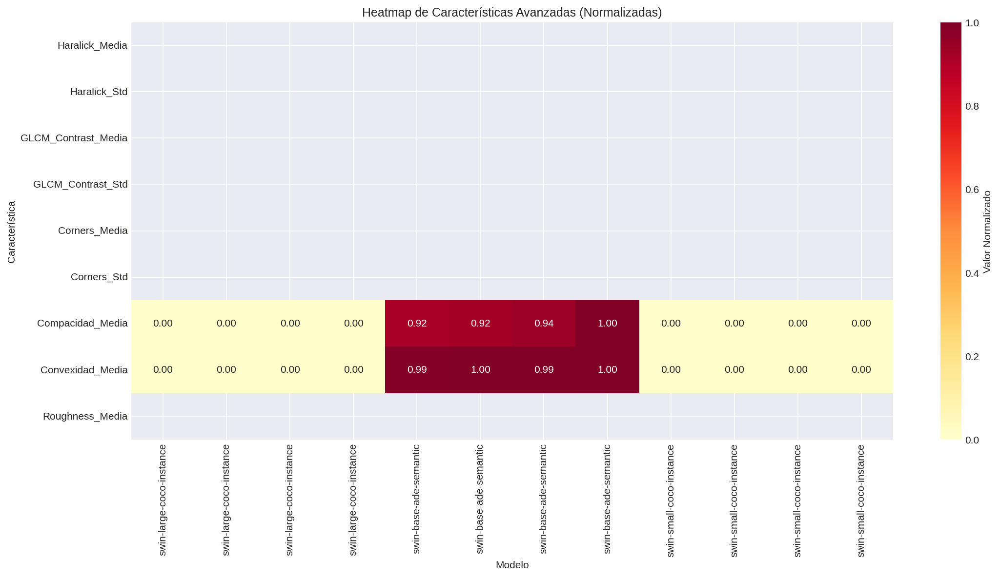

✅ Heatmap guardado: /content/drive/MyDrive/TFM/mask2former/analisis_exports/graficas/heatmap_caracteristicas.png


<Figure size 640x480 with 0 Axes>

In [10]:
# =============================================================================
# 1.4 ANÁLISIS DE CARACTERÍSTICAS AVANZADAS
# =============================================================================

print("\n" + "-"*80)
print("1.4 ANÁLISIS DE CARACTERÍSTICAS AVANZADAS")
print("-"*80 + "\n")

# Recopilar características avanzadas
datos_caracteristicas = []

for resultado in todos_resultados:
    resumen = resultado['resumen']
    metadatos = resultado['metadatos']

    modelo_eval = metadatos.get('modelo_evaluado', {})
    stats_carac = resumen.get('estadisticas_caracteristicas_avanzadas', {})
    stats_shapely = resumen.get('estadisticas_mascaras_shapely', {})

    if stats_carac:
        haralick = stats_carac.get('haralick_estadisticas', {})
        glcm = stats_carac.get('glcm_contrast_estadisticas', {})
        corners = stats_carac.get('corners_estadisticas', {})

        datos_caracteristicas.append({
            'Modelo': modelo_eval.get('nombre_corto', 'N/A'),
            'Haralick_Media': haralick.get('mean', 0),
            'Haralick_Std': haralick.get('std', 0),
            'GLCM_Contrast_Media': glcm.get('mean', 0),
            'GLCM_Contrast_Std': glcm.get('std', 0),
            'Corners_Media': corners.get('mean', 0),
            'Corners_Std': corners.get('std', 0),
            'Compacidad_Media': stats_shapely.get('compactness_estadisticas', {}).get('mean', 0),
            'Convexidad_Media': stats_shapely.get('convexity_ratio_estadisticas', {}).get('mean', 0),
            'Roughness_Media': stats_shapely.get('roughness_estadisticas', {}).get('mean', 0)
        })

df_caracteristicas = pd.DataFrame(datos_caracteristicas)

# Heatmap de características
if not df_caracteristicas.empty:
    fig, ax = plt.subplots(figsize=config.FIGSIZE_MEDIANO, dpi=config.DPI)

    # Preparar datos para heatmap
    df_heat = df_caracteristicas.set_index('Modelo')
    df_heat_norm = (df_heat - df_heat.min()) / (df_heat.max() - df_heat.min())

    sns.heatmap(df_heat_norm.T, annot=True, fmt='.2f', cmap='YlOrRd',
                cbar_kws={'label': 'Valor Normalizado'}, ax=ax)
    ax.set_title('Heatmap de Características Avanzadas (Normalizadas)')
    ax.set_xlabel('Modelo')
    ax.set_ylabel('Característica')
    plt.tight_layout()
    plt.show()

    # Guardar
    fig_path = config.OUTPUT_PATH / "graficas" / "heatmap_caracteristicas.png"
    plt.savefig(fig_path, dpi=config.DPI, bbox_inches='tight')
    print(f"✅ Heatmap guardado: {fig_path}")

In [20]:
# =============================================================================
# 1.5 RESUMEN ESTADÍSTICO FINAL
# =============================================================================

print("\n" + "-"*80)
print("1.5 RESUMEN ESTADÍSTICO FINAL")
print("-"*80 + "\n")

resumen_final = {
    'Total Ejecuciones': len(estructura),
    'Total Modelos Evaluados': df_comparativo['Modelo'].nunique(),
    'Total Configuraciones': df_comparativo['Config_Umbral'].nunique(),
    'Total Imágenes Procesadas': df_comparativo['Total_Imágenes'].sum(),
    'Total Personas Detectadas': df_comparativo['Total_Personas'].sum(),
    'Tiempo Promedio Global (ms)': df_comparativo['Tiempo_Promedio_ms'].mean(),
    'Memoria Promedio Global (MB)': df_comparativo['Memoria_Promedio_MB'].mean(),
    'Score Confianza Promedio': df_comparativo['Score_Promedio'].mean(),
    'Tasa Validez Shapely Promedio (%)': df_comparativo['Tasa_Validez_Shapely_%'].mean()
}

print("📈 RESUMEN GLOBAL DE LA EVALUACIÓN")
print("="*80)
for key, value in resumen_final.items():
    print(f"{key:.<50} {value:.2f}" if isinstance(value, float) else f"{key:.<50} {value}")
print("="*80)

# Convertir valores NumPy/Pandas a tipos nativos de Python
resumen_final_serializable = {
    key: float(value) if isinstance(value, (float, np.floating))
    else int(value) if isinstance(value, (int, np.integer))
    else value
    for key, value in resumen_final.items()
}

# Exportar resumen
resumen_path = config.OUTPUT_PATH / "tablas" / f"resumen_global_{datetime.now().strftime('%Y%m%d_%H%M%S')}.json"
with open(resumen_path, 'w', encoding='utf-8') as f:
    json.dump(resumen_final_serializable, f, indent=2, ensure_ascii=False)
print(f"\n✅ Resumen exportado: {resumen_path}")

print("\n✅ CELDA 1 COMPLETADA\n")


--------------------------------------------------------------------------------
1.5 RESUMEN ESTADÍSTICO FINAL
--------------------------------------------------------------------------------

📈 RESUMEN GLOBAL DE LA EVALUACIÓN
Total Ejecuciones................................. 1
Total Modelos Evaluados........................... 3
Total Configuraciones............................. 4
Total Imágenes Procesadas......................... 96
Total Personas Detectadas......................... 29
Tiempo Promedio Global (ms)....................... 5969.89
Memoria Promedio Global (MB)...................... 0.00
Score Confianza Promedio.......................... 0.33
Tasa Validez Shapely Promedio (%)................. 33.33

✅ Resumen exportado: /content/drive/MyDrive/TFM/mask2former/analisis_exports/tablas/resumen_global_20251004_183505.json

✅ CELDA 1 COMPLETADA




CELDA 2: ANÁLISIS GEOMÉTRICO CON SHAPELY

📁 Ejecución seleccionada: ejecucion_20251004_171557
🤖 Modelos disponibles: ['m551_inst_coco', 'm378_sema_ade2', 'm249_inst_coco']

✅ Resultados cargados: 12

📸 Total de imágenes para analizar: 8


IMAGEN 1/8

🤖 Modelo: swin-base-ade-semantic
📄 Imagen: 1.jpg
  Total máscaras en análisis: 1
    Procesando máscara 0...
      ✅ Vértices=10, Área=66.68%, Compacidad=0.506
  ✅ Máscaras válidas pintadas: 1/1
🤖 Modelo: swin-base-ade-semantic
📄 Imagen: 1.jpg
  Total máscaras en análisis: 1
    Procesando máscara 0...
      ✅ Vértices=10, Área=66.68%, Compacidad=0.506
  ✅ Máscaras válidas pintadas: 1/1
🤖 Modelo: swin-base-ade-semantic
📄 Imagen: 1.jpg
  Total máscaras en análisis: 1
    Procesando máscara 0...
      ✅ Vértices=10, Área=66.68%, Compacidad=0.506
  ✅ Máscaras válidas pintadas: 1/1


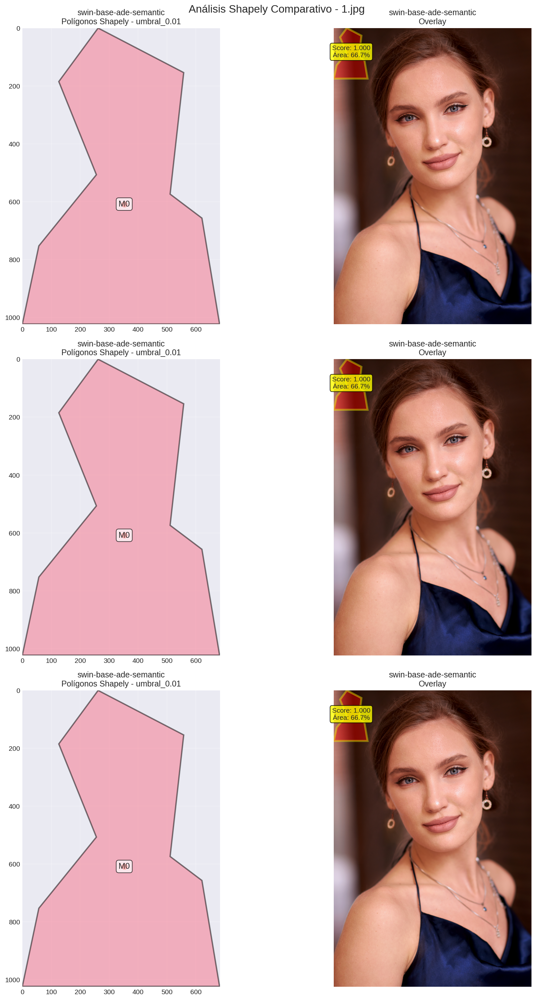


✅ Figura guardada: /content/drive/MyDrive/TFM/mask2former/analisis_exports/graficas/shapely_img1_20251004_185301.png

IMAGEN 2/8

🤖 Modelo: swin-base-ade-semantic
📄 Imagen: 2.jpg
  Total máscaras en análisis: 1
    Procesando máscara 0...
      ✅ Vértices=7, Área=31.84%, Compacidad=0.264
  ✅ Máscaras válidas pintadas: 1/1
🤖 Modelo: swin-base-ade-semantic
📄 Imagen: 2.jpg
  Total máscaras en análisis: 1
    Procesando máscara 0...
      ✅ Vértices=7, Área=31.84%, Compacidad=0.264
  ✅ Máscaras válidas pintadas: 1/1
🤖 Modelo: swin-base-ade-semantic
📄 Imagen: 2.jpg
  Total máscaras en análisis: 1
    Procesando máscara 0...
      ✅ Vértices=7, Área=31.84%, Compacidad=0.264
  ✅ Máscaras válidas pintadas: 1/1


<Figure size 640x480 with 0 Axes>

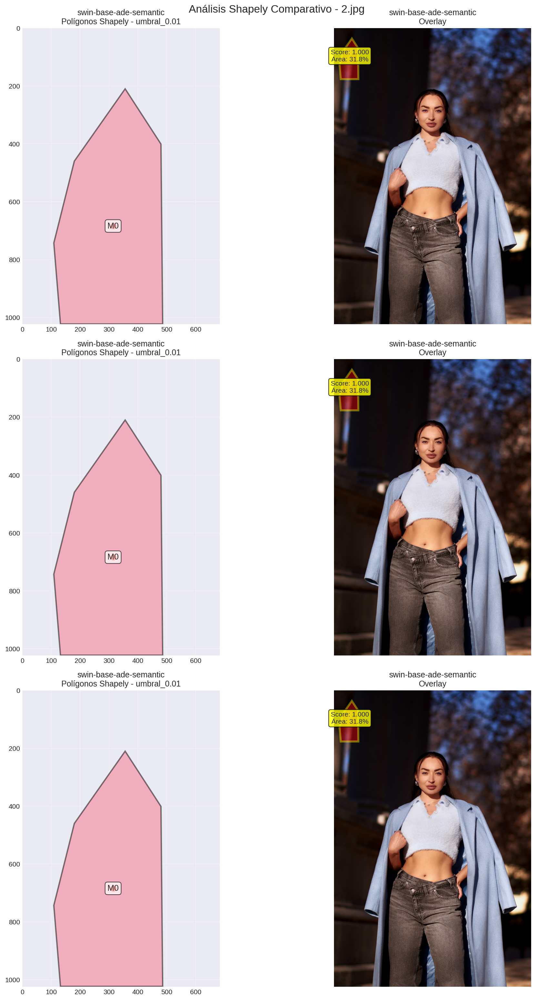


✅ Figura guardada: /content/drive/MyDrive/TFM/mask2former/analisis_exports/graficas/shapely_img2_20251004_185309.png

IMAGEN 3/8

🤖 Modelo: swin-base-ade-semantic
📄 Imagen: 3.jpg
  Total máscaras en análisis: 1
    Procesando máscara 0...
      ✅ Vértices=12, Área=39.32%, Compacidad=0.366
  ✅ Máscaras válidas pintadas: 1/1
🤖 Modelo: swin-base-ade-semantic
📄 Imagen: 3.jpg
  Total máscaras en análisis: 1
    Procesando máscara 0...
      ✅ Vértices=12, Área=39.32%, Compacidad=0.366
  ✅ Máscaras válidas pintadas: 1/1
🤖 Modelo: swin-base-ade-semantic
📄 Imagen: 3.jpg
  Total máscaras en análisis: 1
    Procesando máscara 0...
      ✅ Vértices=12, Área=39.32%, Compacidad=0.366
  ✅ Máscaras válidas pintadas: 1/1


<Figure size 640x480 with 0 Axes>

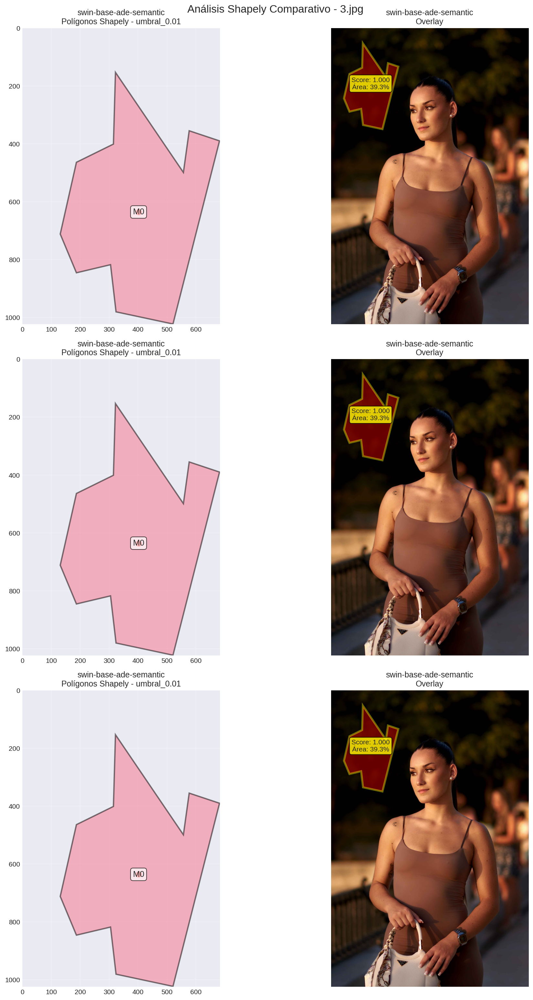


✅ Figura guardada: /content/drive/MyDrive/TFM/mask2former/analisis_exports/graficas/shapely_img3_20251004_185312.png

IMAGEN 4/8

🤖 Modelo: swin-base-ade-semantic
📄 Imagen: 5.jpg
  Total máscaras en análisis: 1
    Procesando máscara 0...
      ✅ Vértices=8, Área=10.07%, Compacidad=0.648
  ✅ Máscaras válidas pintadas: 1/1
🤖 Modelo: swin-base-ade-semantic
📄 Imagen: 5.jpg
  Total máscaras en análisis: 1
    Procesando máscara 0...
      ✅ Vértices=8, Área=10.07%, Compacidad=0.648
  ✅ Máscaras válidas pintadas: 1/1
🤖 Modelo: swin-base-ade-semantic
📄 Imagen: 5.jpg
  Total máscaras en análisis: 1
    Procesando máscara 0...
      ✅ Vértices=8, Área=10.07%, Compacidad=0.648
  ✅ Máscaras válidas pintadas: 1/1


<Figure size 640x480 with 0 Axes>

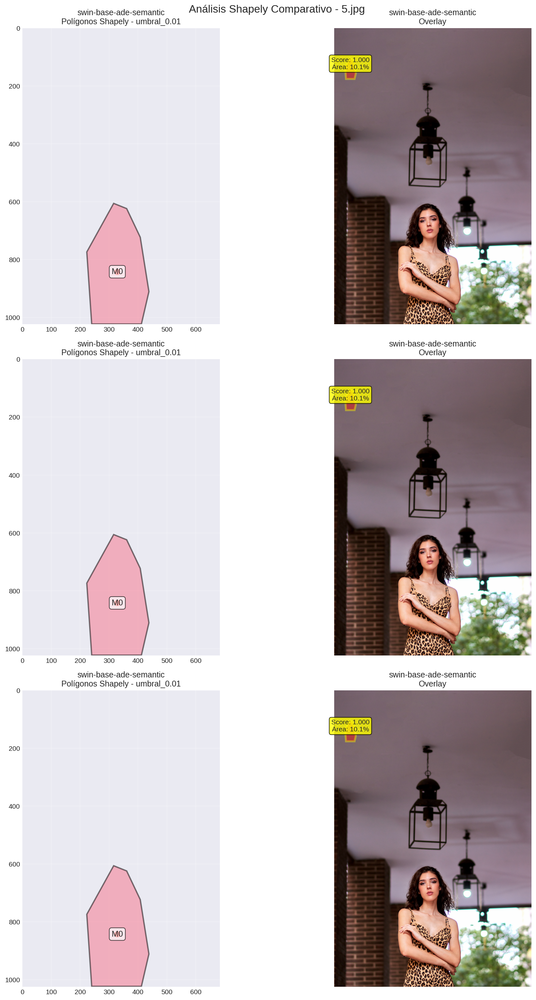


✅ Figura guardada: /content/drive/MyDrive/TFM/mask2former/analisis_exports/graficas/shapely_img4_20251004_185321.png

IMAGEN 5/8

🤖 Modelo: swin-base-ade-semantic
📄 Imagen: 6.jpg
  Total máscaras en análisis: 1
    Procesando máscara 0...
      ✅ Vértices=8, Área=19.30%, Compacidad=0.271
  ✅ Máscaras válidas pintadas: 1/1
🤖 Modelo: swin-base-ade-semantic
📄 Imagen: 6.jpg
  Total máscaras en análisis: 1
    Procesando máscara 0...
      ✅ Vértices=8, Área=19.30%, Compacidad=0.271
  ✅ Máscaras válidas pintadas: 1/1
🤖 Modelo: swin-base-ade-semantic
📄 Imagen: 6.jpg
  Total máscaras en análisis: 1
    Procesando máscara 0...
      ✅ Vértices=8, Área=19.30%, Compacidad=0.271
  ✅ Máscaras válidas pintadas: 1/1


<Figure size 640x480 with 0 Axes>

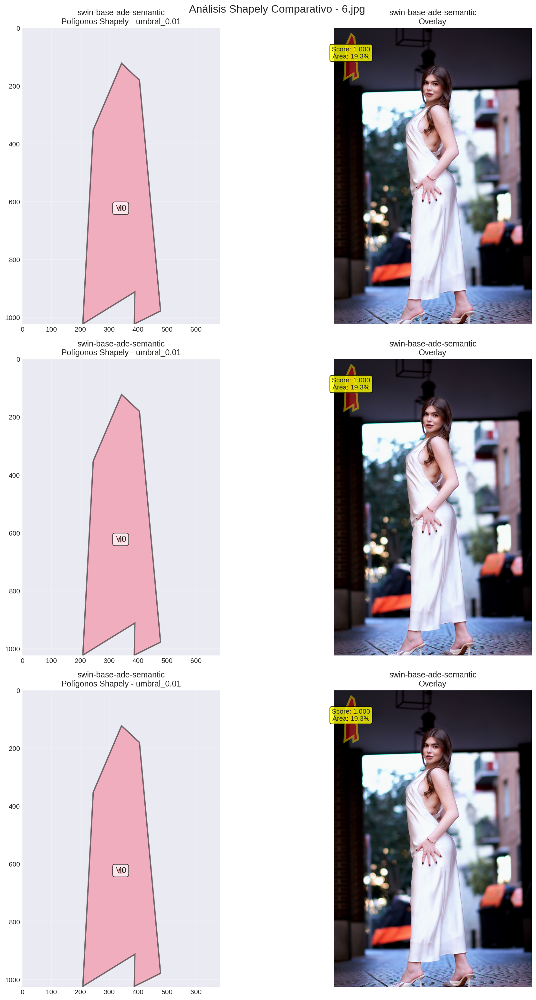


✅ Figura guardada: /content/drive/MyDrive/TFM/mask2former/analisis_exports/graficas/shapely_img5_20251004_185329.png

✅ CELDA 2 COMPLETADA



<Figure size 640x480 with 0 Axes>

In [25]:
# =============================================================================
# ANÁLISIS GEOMÉTRICO (Shapely)
# =============================================================================

print("\n" + "="*80)
print("CELDA 2: ANÁLISIS GEOMÉTRICO CON SHAPELY")
print("="*80 + "\n")

# Seleccionar ejecución y modelos para comparar
if len(estructura) > 0:
    # Usar la ejecución más reciente
    nombre_ejecucion = sorted(estructura.keys())[-1]
    ejecucion_path = estructura[nombre_ejecucion]['path']

    print(f"📁 Ejecución seleccionada: {nombre_ejecucion}")
    print(f"🤖 Modelos disponibles: {list(estructura[nombre_ejecucion]['modelos'].keys())}\n")

    # Inicializar gestor de máscaras
    gestor_mascaras = GestorMascaras(ejecucion_path)

    # Seleccionar primer resultado de cada modelo para comparación
    resultados_seleccionados = []

    for resultado in todos_resultados:
        if resultado['info_archivo']['ejecucion'] == nombre_ejecucion:
            resultados_seleccionados.append(resultado)

    if not resultados_seleccionados:
        print("❌ No se encontraron resultados en la ejecución seleccionada")
    else:
        print(f"✅ Resultados cargados: {len(resultados_seleccionados)}\n")

        # Seleccionar umbral para visualización
        umbral_visual = 'umbral_0.01'  # Ajustar según necesidad

        # Iterar por cada imagen en los resultados
        primer_resultado = resultados_seleccionados[0]
        num_imagenes = len(primer_resultado['resultados_detallados'])

        print(f"📸 Total de imágenes para analizar: {num_imagenes}\n")

        # Análisis por imagen
        for idx_imagen in range(min(num_imagenes, 5)):  # Limitar a 5 imágenes para visualización
            print(f"\n{'='*80}")
            print(f"IMAGEN {idx_imagen + 1}/{num_imagenes}")
            print(f"{'='*80}\n")

            # FILTRAR: Solo modelos con datos válidos para esta imagen
            modelos_validos = []

            for resultado in resultados_seleccionados:
                resultado_img = resultado['resultados_detallados'][idx_imagen]
                detecciones = resultado_img['deteccion']['detecciones_por_umbral']

                if umbral_visual in detecciones:
                    deteccion = detecciones[umbral_visual]
                    analisis = deteccion.get('analisis_mascaras_avanzado')

                    if analisis and analisis.get('mascaras_individuales'):
                        # Verificar si hay al menos una máscara válida
                        tiene_mascaras_validas = False
                        for mascara_data in analisis['mascaras_individuales']:
                            if 'error' not in mascara_data:
                                shapely_geom = mascara_data.get('shapely_geometry', {})
                                if shapely_geom.get('polygon_valido'):
                                    polygon_str = shapely_geom.get('polygon')
                                    if polygon_str and polygon_str != "None":
                                        tiene_mascaras_validas = True
                                        break

                        if tiene_mascaras_validas:
                            modelos_validos.append(resultado)

            # Si no hay modelos válidos, saltar esta imagen
            if not modelos_validos:
                print(f"⚠️ No hay datos válidos para la imagen {idx_imagen + 1}, omitiendo...\n")
                continue

            # Crear figura solo con modelos válidos
            num_modelos = len(modelos_validos)
            fig, axes = plt.subplots(num_modelos, 2, figsize=(15, 7*num_modelos), dpi=config.DPI)

            if num_modelos == 1:
                axes = axes.reshape(1, -1)

            for idx_modelo, resultado in enumerate(modelos_validos):
                metadatos = resultado['metadatos']
                modelo_nombre = metadatos['modelo_evaluado']['nombre_corto']

                resultado_img = resultado['resultados_detallados'][idx_imagen]
                nombre_archivo = resultado_img['imagen']['archivo']
                ruta_imagen = resultado_img['imagen']['ruta_completa']

                print(f"🤖 Modelo: {modelo_nombre}")
                print(f"📄 Imagen: {nombre_archivo}")

                # Cargar imagen original
                img_original = None
                try:
                    img_original = Image.open(ruta_imagen)
                except:
                    print(f"  ⚠️ Imagen original no disponible")

                # Dimensiones
                dims = resultado_img['imagen']['caracteristicas_avanzadas']['metadatos_basicos']['dimensiones']
                width, height = dims['ancho'], dims['alto']

                # Obtener detección
                detecciones = resultado_img['deteccion']['detecciones_por_umbral']
                deteccion = detecciones[umbral_visual]
                analisis = deteccion.get('analisis_mascaras_avanzado')

                # Columna 1: Polígonos Shapely puros
                ax1 = axes[idx_modelo, 0]
                ax1.set_xlim(0, width)
                ax1.set_ylim(height, 0)
                ax1.set_aspect('equal')
                ax1.set_title(f'{modelo_nombre}\nPolígonos Shapely - {umbral_visual}')
                ax1.grid(True, alpha=0.3)

                # Columna 2: Overlay sobre imagen
                ax2 = axes[idx_modelo, 1]
                if img_original:
                    ax2.imshow(img_original)
                ax2.set_title(f'{modelo_nombre}\nOverlay')
                ax2.axis('off')

                # Procesar cada máscara (SOLO LAS VÁLIDAS)
                mascaras_individuales = analisis['mascaras_individuales']
                mascaras_validas = 0

                print(f"  Total máscaras en análisis: {len(mascaras_individuales)}")

                for j, mascara_data in enumerate(mascaras_individuales):
                    print(f"    Procesando máscara {j}...")

                    # Saltar máscaras con errores
                    if 'error' in mascara_data:
                        print(f"      ❌ Tiene error: {mascara_data.get('error')}")
                        continue

                    shapely_geom = mascara_data.get('shapely_geometry', {})

                    # Saltar polígonos no válidos
                    if not shapely_geom.get('polygon_valido'):
                        print(f"      ❌ Polígono no válido")
                        continue

                    # Parsear polígono WKT
                    polygon_str = shapely_geom.get('polygon')
                    if not polygon_str or polygon_str == "None":
                        print(f"      ❌ Sin datos de polígono")
                        continue

                    try:
                        polygon = wkt.loads(polygon_str)
                        coords = list(polygon.exterior.coords)

                        # Características geométricas
                        geom_features = mascara_data.get('caracteristicas_geometricas', {})
                        area_pct = geom_features.get('area_percentage', 0)
                        compactness = geom_features.get('compactness', 0)

                        print(f"      ✅ Vértices={len(coords)}, Área={area_pct:.2f}%, Compacidad={compactness:.3f}")

                        # Dibujar en ambos axes
                        # Polígono puro
                        poly_patch1 = MplPolygon(coords,
                                                facecolor=f'C{mascaras_validas}',
                                                edgecolor='black',
                                                alpha=0.5,
                                                linewidth=2)
                        ax1.add_patch(poly_patch1)

                        # Centroide
                        centroid = shapely_geom.get('centroid_shapely', [0, 0])
                        ax1.plot(centroid[0], centroid[1], 'ro', markersize=8)
                        ax1.text(centroid[0], centroid[1], f'M{mascaras_validas}',
                                fontsize=12, ha='center', va='center',
                                bbox=dict(boxstyle='round', facecolor='white', alpha=0.7))

                        # Overlay
                        poly_patch2 = MplPolygon(coords,
                                                facecolor='red',
                                                edgecolor='yellow',
                                                alpha=0.4,
                                                linewidth=3)
                        ax2.add_patch(poly_patch2)

                        # Score de confianza
                        score = mascara_data.get('score_confianza', 0)
                        ax2.text(centroid[0], centroid[1]-20,
                                f'Score: {score:.3f}\nÁrea: {area_pct:.1f}%',
                                fontsize=10, ha='center',
                                bbox=dict(boxstyle='round', facecolor='yellow', alpha=0.8))

                        mascaras_validas += 1

                    except Exception as e:
                        print(f"      ❌ Error parseando - {str(e)}")
                        continue

                print(f"  ✅ Máscaras válidas pintadas: {mascaras_validas}/{len(mascaras_individuales)}")

            plt.suptitle(f'Análisis Shapely Comparativo - {nombre_archivo}', fontsize=16)
            plt.tight_layout()
            plt.show()

            # Guardar figura
            fig_path = config.OUTPUT_PATH / "graficas" / f"shapely_img{idx_imagen+1}_{datetime.now().strftime('%Y%m%d_%H%M%S')}.png"
            plt.savefig(fig_path, dpi=config.DPI, bbox_inches='tight')
            print(f"\n✅ Figura guardada: {fig_path}")

print("\n✅ CELDA 2 COMPLETADA\n")


CELDA 3: ANÁLISIS DE MÁSCARAS RAW DESDE NPZ

📸 Analizando máscaras raw para 8 imágenes


IMAGEN 1/8 - MÁSCARAS RAW


🤖 Modelo: swin-base-ade-semantic
📄 Imagen: 1.jpg
  📊 Total de máscaras individuales: 1
    Máscara 0: 466355 píxeles activos (66.7% cobertura)
  ✅ Máscaras activas: 1/1


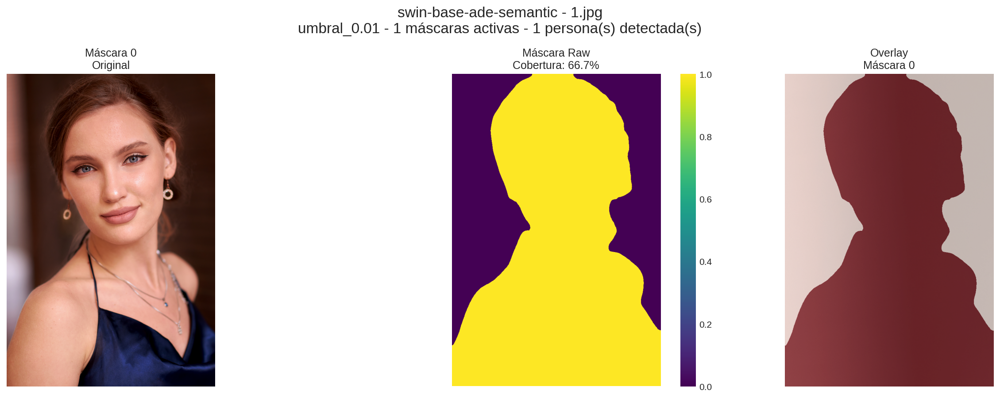


✅ Figura guardada: /content/drive/MyDrive/TFM/mask2former/analisis_exports/graficas/mascaras_raw_swin-base-ade-semantic_img1_20251004_185520.png


<Figure size 640x480 with 0 Axes>

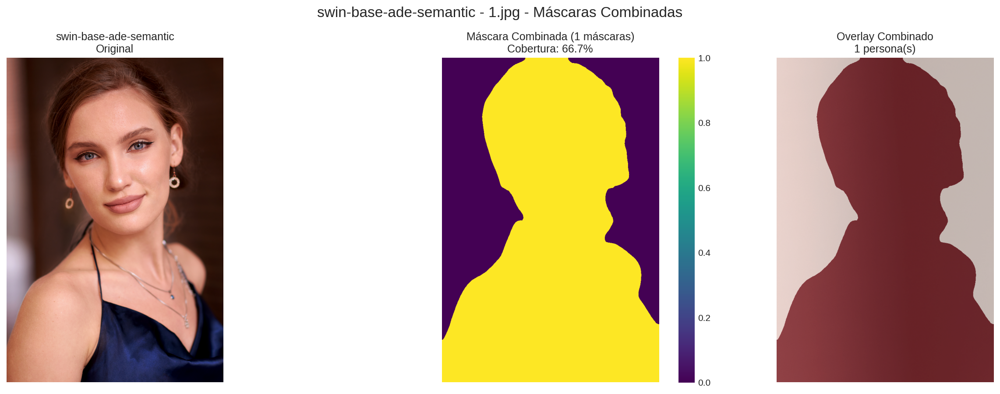

✅ Figura combinada guardada: /content/drive/MyDrive/TFM/mask2former/analisis_exports/graficas/mascaras_raw_combinadas_swin-base-ade-semantic_img1_20251004_185524.png


🤖 Modelo: swin-base-ade-semantic
📄 Imagen: 1.jpg
  📊 Total de máscaras individuales: 1
    Máscara 0: 466355 píxeles activos (66.7% cobertura)
  ✅ Máscaras activas: 1/1


<Figure size 640x480 with 0 Axes>

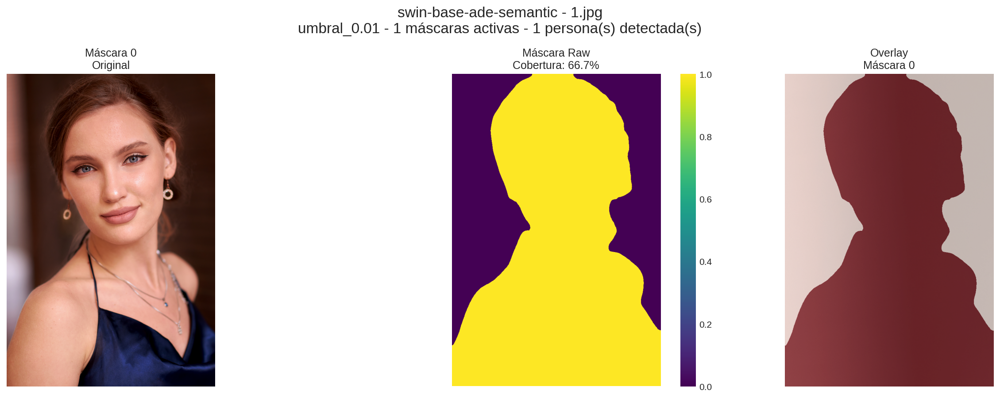


✅ Figura guardada: /content/drive/MyDrive/TFM/mask2former/analisis_exports/graficas/mascaras_raw_swin-base-ade-semantic_img1_20251004_185528.png


<Figure size 640x480 with 0 Axes>

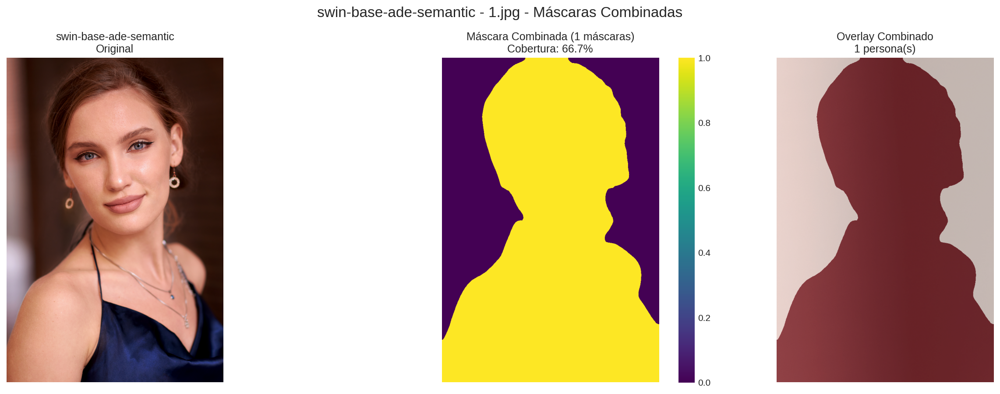

✅ Figura combinada guardada: /content/drive/MyDrive/TFM/mask2former/analisis_exports/graficas/mascaras_raw_combinadas_swin-base-ade-semantic_img1_20251004_185531.png


🤖 Modelo: swin-base-ade-semantic
📄 Imagen: 1.jpg
  📊 Total de máscaras individuales: 1
    Máscara 0: 466355 píxeles activos (66.7% cobertura)
  ✅ Máscaras activas: 1/1


<Figure size 640x480 with 0 Axes>

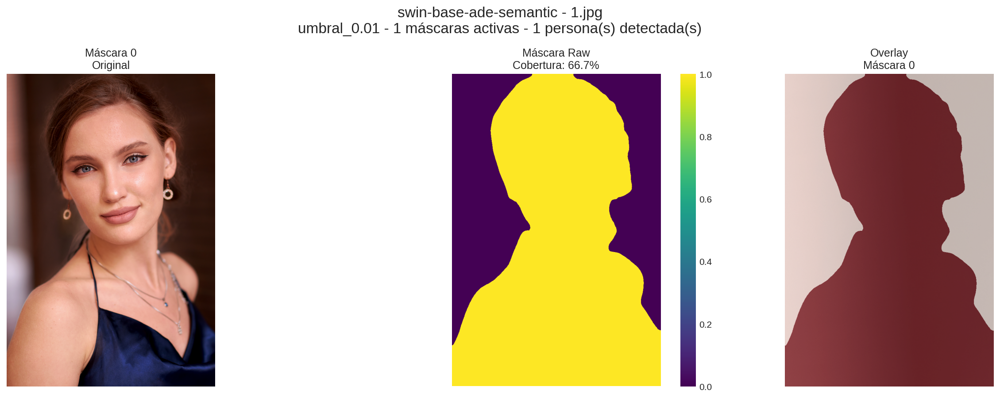


✅ Figura guardada: /content/drive/MyDrive/TFM/mask2former/analisis_exports/graficas/mascaras_raw_swin-base-ade-semantic_img1_20251004_185535.png


<Figure size 640x480 with 0 Axes>

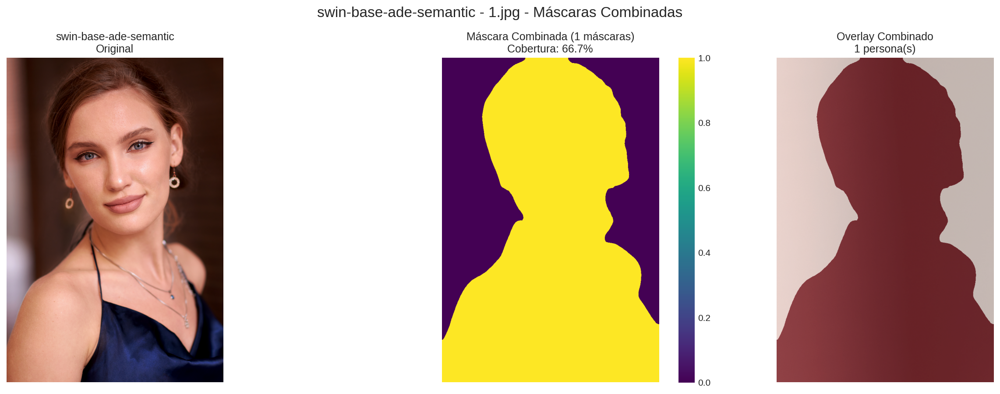

✅ Figura combinada guardada: /content/drive/MyDrive/TFM/mask2former/analisis_exports/graficas/mascaras_raw_combinadas_swin-base-ade-semantic_img1_20251004_185540.png


IMAGEN 2/8 - MÁSCARAS RAW


🤖 Modelo: swin-base-ade-semantic
📄 Imagen: 2.jpg
  📊 Total de máscaras individuales: 1
    Máscara 0: 222720 píxeles activos (31.8% cobertura)
  ✅ Máscaras activas: 1/1


<Figure size 640x480 with 0 Axes>

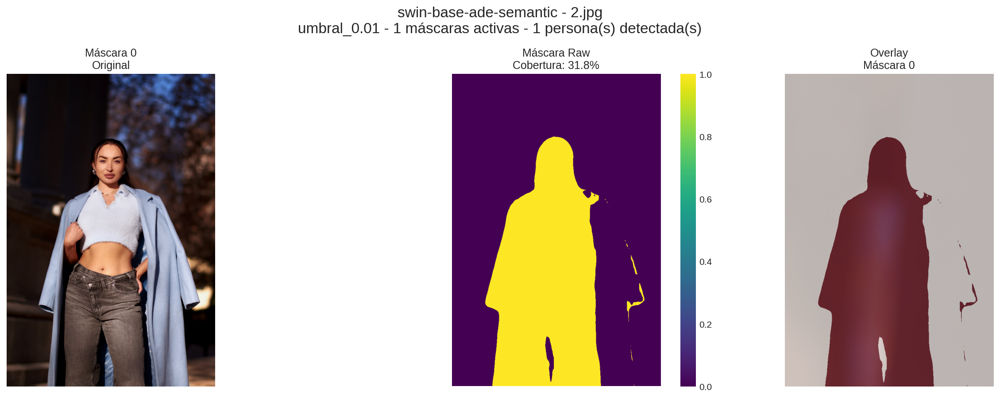


✅ Figura guardada: /content/drive/MyDrive/TFM/mask2former/analisis_exports/graficas/mascaras_raw_swin-base-ade-semantic_img2_20251004_185543.png


<Figure size 640x480 with 0 Axes>

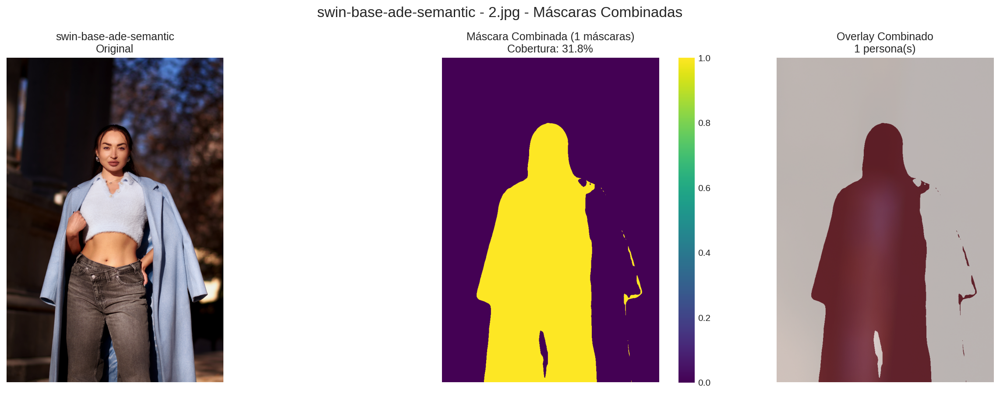

✅ Figura combinada guardada: /content/drive/MyDrive/TFM/mask2former/analisis_exports/graficas/mascaras_raw_combinadas_swin-base-ade-semantic_img2_20251004_185546.png


🤖 Modelo: swin-base-ade-semantic
📄 Imagen: 2.jpg
  📊 Total de máscaras individuales: 1
    Máscara 0: 222720 píxeles activos (31.8% cobertura)
  ✅ Máscaras activas: 1/1


<Figure size 640x480 with 0 Axes>

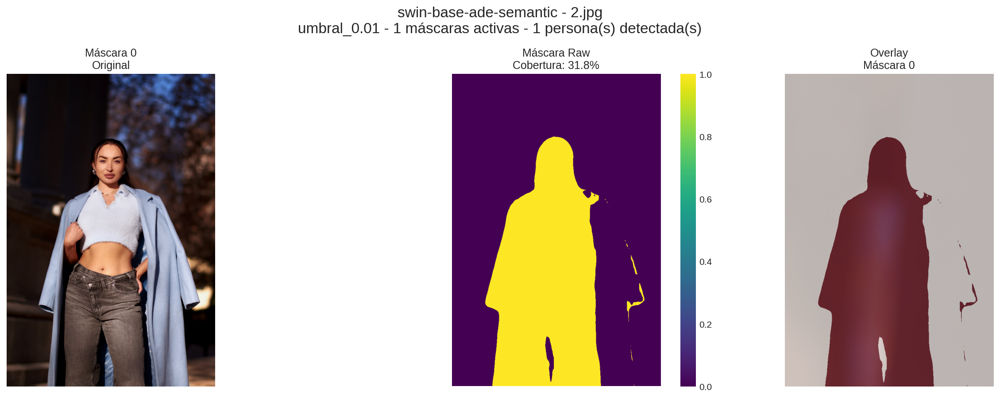


✅ Figura guardada: /content/drive/MyDrive/TFM/mask2former/analisis_exports/graficas/mascaras_raw_swin-base-ade-semantic_img2_20251004_185550.png


<Figure size 640x480 with 0 Axes>

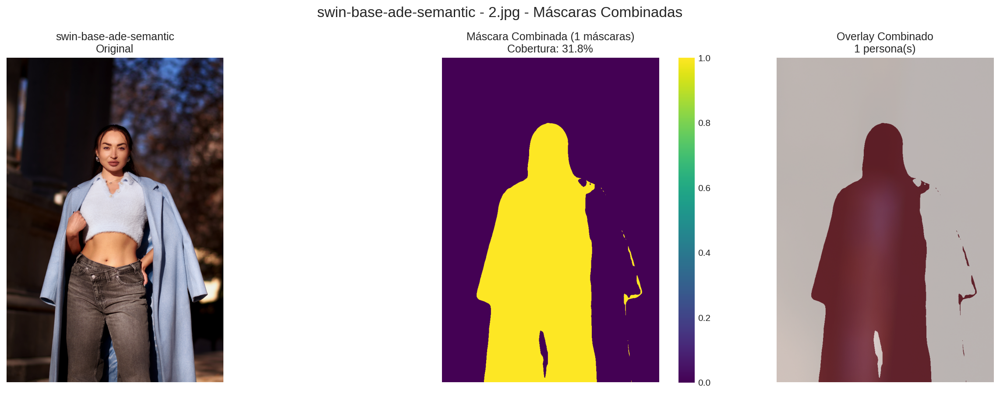

✅ Figura combinada guardada: /content/drive/MyDrive/TFM/mask2former/analisis_exports/graficas/mascaras_raw_combinadas_swin-base-ade-semantic_img2_20251004_185554.png


🤖 Modelo: swin-base-ade-semantic
📄 Imagen: 2.jpg
  📊 Total de máscaras individuales: 1
    Máscara 0: 222720 píxeles activos (31.8% cobertura)
  ✅ Máscaras activas: 1/1


<Figure size 640x480 with 0 Axes>

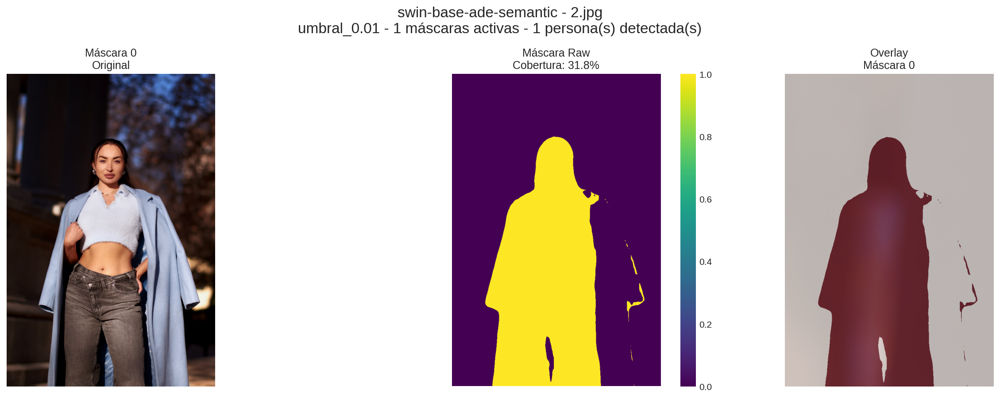


✅ Figura guardada: /content/drive/MyDrive/TFM/mask2former/analisis_exports/graficas/mascaras_raw_swin-base-ade-semantic_img2_20251004_185558.png


<Figure size 640x480 with 0 Axes>

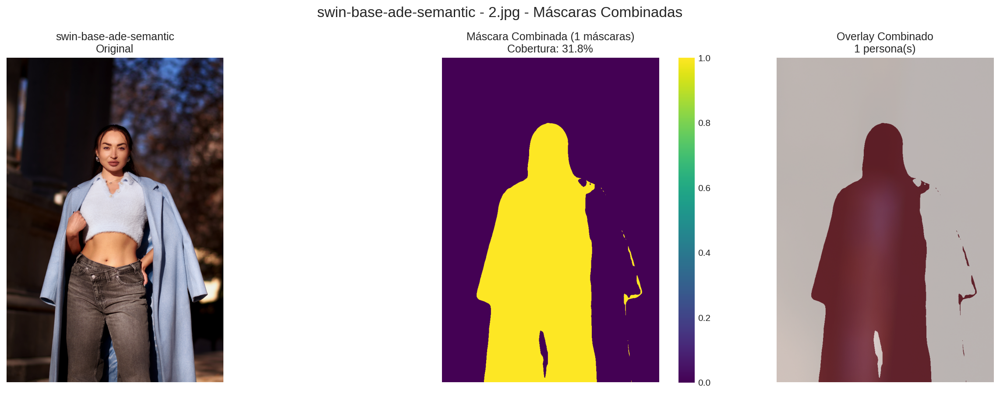

✅ Figura combinada guardada: /content/drive/MyDrive/TFM/mask2former/analisis_exports/graficas/mascaras_raw_combinadas_swin-base-ade-semantic_img2_20251004_185601.png


IMAGEN 3/8 - MÁSCARAS RAW


🤖 Modelo: swin-base-ade-semantic
📄 Imagen: 3.jpg
  📊 Total de máscaras individuales: 1
    Máscara 0: 275012 píxeles activos (39.3% cobertura)
  ✅ Máscaras activas: 1/1


<Figure size 640x480 with 0 Axes>

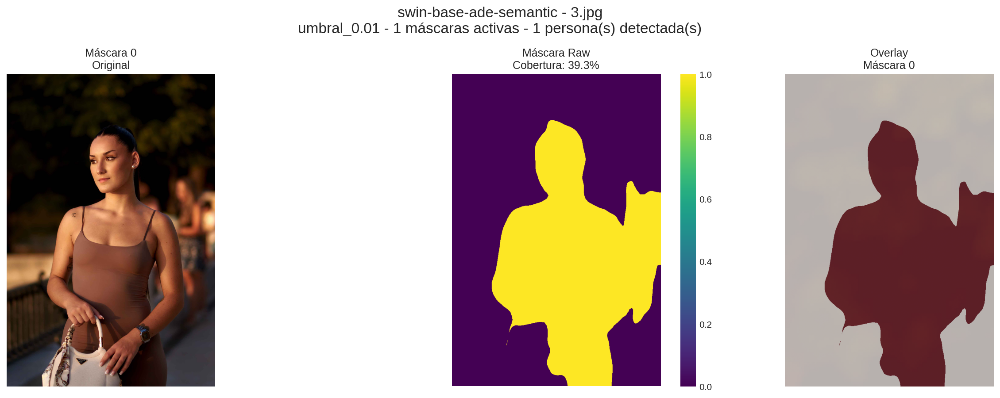


✅ Figura guardada: /content/drive/MyDrive/TFM/mask2former/analisis_exports/graficas/mascaras_raw_swin-base-ade-semantic_img3_20251004_185603.png


<Figure size 640x480 with 0 Axes>

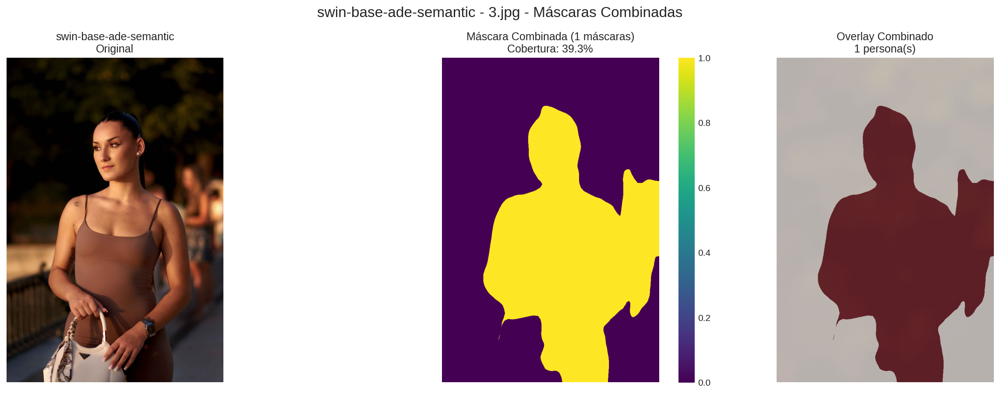

✅ Figura combinada guardada: /content/drive/MyDrive/TFM/mask2former/analisis_exports/graficas/mascaras_raw_combinadas_swin-base-ade-semantic_img3_20251004_185605.png


🤖 Modelo: swin-base-ade-semantic
📄 Imagen: 3.jpg
  📊 Total de máscaras individuales: 1
    Máscara 0: 275012 píxeles activos (39.3% cobertura)
  ✅ Máscaras activas: 1/1


<Figure size 640x480 with 0 Axes>

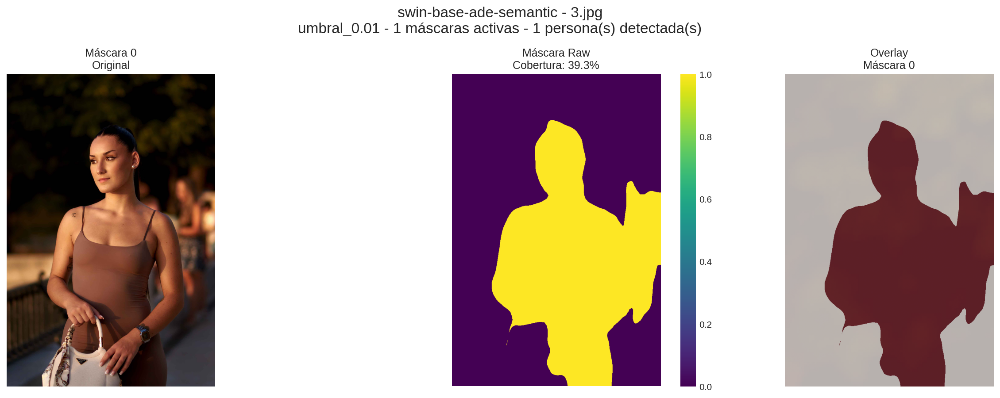


✅ Figura guardada: /content/drive/MyDrive/TFM/mask2former/analisis_exports/graficas/mascaras_raw_swin-base-ade-semantic_img3_20251004_185607.png


<Figure size 640x480 with 0 Axes>

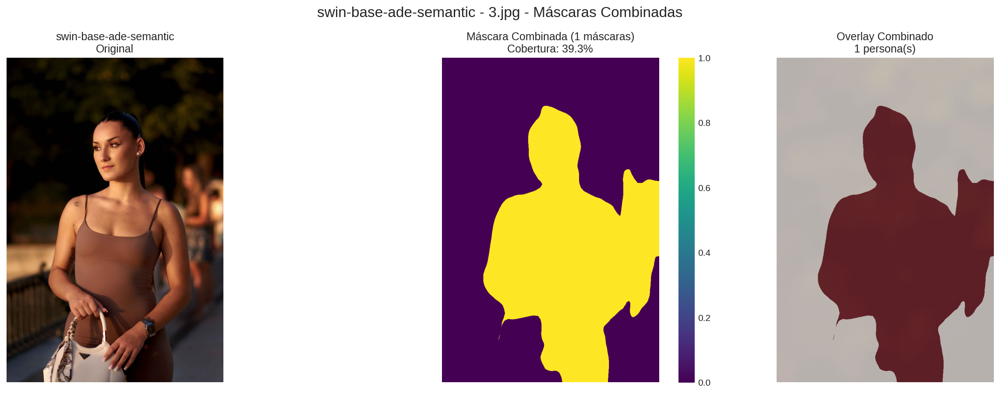

✅ Figura combinada guardada: /content/drive/MyDrive/TFM/mask2former/analisis_exports/graficas/mascaras_raw_combinadas_swin-base-ade-semantic_img3_20251004_185609.png


🤖 Modelo: swin-base-ade-semantic
📄 Imagen: 3.jpg
  📊 Total de máscaras individuales: 1
    Máscara 0: 275012 píxeles activos (39.3% cobertura)
  ✅ Máscaras activas: 1/1


<Figure size 640x480 with 0 Axes>

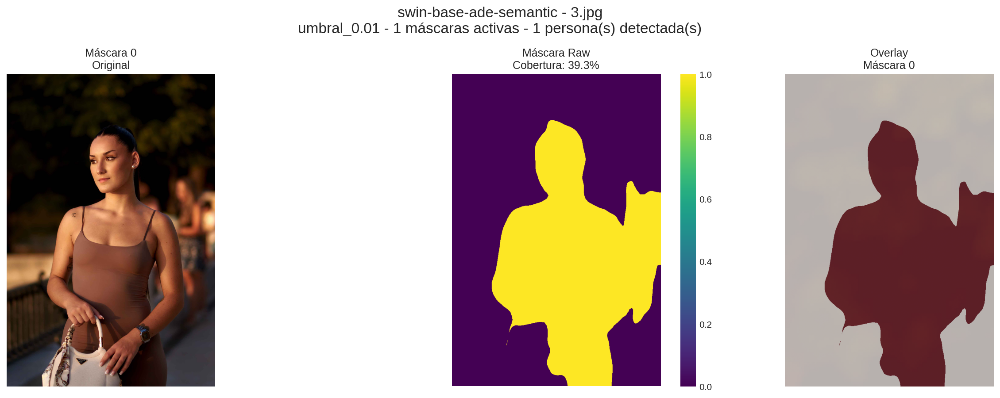


✅ Figura guardada: /content/drive/MyDrive/TFM/mask2former/analisis_exports/graficas/mascaras_raw_swin-base-ade-semantic_img3_20251004_185611.png


<Figure size 640x480 with 0 Axes>

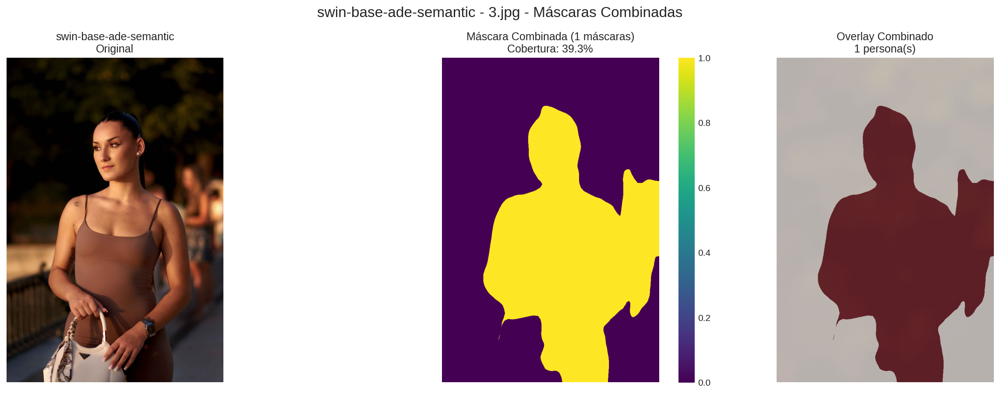

✅ Figura combinada guardada: /content/drive/MyDrive/TFM/mask2former/analisis_exports/graficas/mascaras_raw_combinadas_swin-base-ade-semantic_img3_20251004_185613.png


✅ CELDA 3 COMPLETADA



<Figure size 640x480 with 0 Axes>

In [26]:
# =============================================================================
# ANÁLISIS DE MÁSCARAS RAW DESDE NPZ
# =============================================================================

print("\n" + "="*80)
print("CELDA 3: ANÁLISIS DE MÁSCARAS RAW DESDE NPZ")
print("="*80 + "\n")

if len(estructura) > 0:
    nombre_ejecucion = sorted(estructura.keys())[-1]
    ejecucion_path = estructura[nombre_ejecucion]['path']

    gestor_mascaras = GestorMascaras(ejecucion_path)

    # Umbral para visualización
    umbral_visual = 'umbral_0.01'

    # Iterar por resultados
    resultados_sel = [r for r in todos_resultados if r['info_archivo']['ejecucion'] == nombre_ejecucion]

    if resultados_sel:
        primer_resultado = resultados_sel[0]
        num_imagenes = len(primer_resultado['resultados_detallados'])

        print(f"📸 Analizando máscaras raw para {num_imagenes} imágenes\n")

        # Analizar cada imagen
        for idx_imagen in range(min(num_imagenes, 3)):  # Limitar a 3 imágenes
            print(f"\n{'='*80}")
            print(f"IMAGEN {idx_imagen + 1}/{num_imagenes} - MÁSCARAS RAW")
            print(f"{'='*80}\n")

            # FILTRAR: Solo modelos con máscaras válidas para esta imagen
            modelos_validos = []
            datos_mascaras_cache = {}

            for idx_resultado, resultado in enumerate(resultados_sel):
                resultado_img = resultado['resultados_detallados'][idx_imagen]
                archivo_mascaras = resultado_img.get('mascaras', {}).get('archivo_mascaras')

                if not archivo_mascaras:
                    continue

                # Cargar máscaras desde NPZ
                datos_mascaras = gestor_mascaras.cargar_mascaras_imagen(archivo_mascaras)

                if not datos_mascaras:
                    continue

                # Verificar si hay máscaras válidas para el umbral
                if umbral_visual not in datos_mascaras['mascaras_por_umbral']:
                    continue

                masks_list = datos_mascaras['mascaras_por_umbral'][umbral_visual]

                if not masks_list or len(masks_list) == 0:
                    continue

                # Verificar que haya al menos una máscara con píxeles activos
                tiene_mascaras_activas = False
                for mask in masks_list:
                    if np.sum(mask > 0.5) > 0:
                        tiene_mascaras_activas = True
                        break

                if tiene_mascaras_activas:
                    modelos_validos.append(resultado)
                    datos_mascaras_cache[idx_resultado] = {
                        'datos': datos_mascaras,
                        'masks_list': masks_list
                    }

            # Si no hay modelos válidos, saltar esta imagen
            if not modelos_validos:
                print(f"⚠️ No hay máscaras válidas para la imagen {idx_imagen + 1}, omitiendo...\n")
                continue

            # Para cada modelo válido, mostrar todas sus máscaras individuales
            for idx_modelo, resultado in enumerate(modelos_validos):
                metadatos = resultado['metadatos']
                modelo_nombre = metadatos['modelo_evaluado']['nombre_corto']

                resultado_img = resultado['resultados_detallados'][idx_imagen]
                nombre_archivo = resultado_img['imagen']['archivo']
                ruta_imagen = resultado_img['imagen']['ruta_completa']

                print(f"\n{'='*60}")
                print(f"🤖 Modelo: {modelo_nombre}")
                print(f"📄 Imagen: {nombre_archivo}")
                print(f"{'='*60}")

                # Cargar imagen original
                img_original = None
                try:
                    img_original = Image.open(ruta_imagen)
                except:
                    print(f"  ⚠️ Imagen original no disponible")

                # Recuperar máscaras del cache
                idx_resultado_original = resultados_sel.index(resultado)
                masks_list = datos_mascaras_cache[idx_resultado_original]['masks_list']

                print(f"  📊 Total de máscaras individuales: {len(masks_list)}")

                # OPCIÓN 1: Mostrar todas las máscaras individuales separadas
                num_mascaras = len(masks_list)

                # Filtrar solo máscaras con píxeles activos
                masks_activas = []
                for i, mask in enumerate(masks_list):
                    pixels_activos = np.sum(mask > 0.5)
                    if pixels_activos > 0:
                        cobertura = pixels_activos / mask.size * 100
                        masks_activas.append({
                            'idx': i,
                            'mask': mask,
                            'pixels': pixels_activos,
                            'cobertura': cobertura
                        })
                        print(f"    Máscara {i}: {pixels_activos} píxeles activos ({cobertura:.1f}% cobertura)")
                    else:
                        print(f"    Máscara {i}: ❌ Sin píxeles activos")

                if not masks_activas:
                    print(f"  ⚠️ No hay máscaras activas para este modelo")
                    continue

                print(f"  ✅ Máscaras activas: {len(masks_activas)}/{num_mascaras}")

                # Crear figura: 1 fila con 3 columnas por cada máscara activa
                num_activas = len(masks_activas)
                fig, axes = plt.subplots(num_activas, 3,
                                        figsize=(18, 6*num_activas),
                                        dpi=config.DPI,
                                        squeeze=False)

                for idx_mask, mask_info in enumerate(masks_activas):
                    mascara_raw = mask_info['mask']
                    idx_original = mask_info['idx']
                    cobertura = mask_info['cobertura']

                    # Columna 1: Imagen original
                    ax1 = axes[idx_mask, 0]
                    if img_original:
                        ax1.imshow(img_original)
                    else:
                        ax1.text(0.5, 0.5, 'Imagen no disponible',
                                ha='center', va='center', transform=ax1.transAxes)
                    ax1.set_title(f'Máscara {idx_original}\nOriginal')
                    ax1.axis('off')

                    # Columna 2: Máscara raw
                    ax2 = axes[idx_mask, 1]
                    im = ax2.imshow(mascara_raw, cmap='viridis', vmin=0, vmax=1)
                    ax2.set_title(f'Máscara Raw\nCobertura: {cobertura:.1f}%')
                    plt.colorbar(im, ax=ax2, fraction=0.046)
                    ax2.axis('off')

                    # Columna 3: Overlay
                    ax3 = axes[idx_mask, 2]
                    if img_original:
                        ax3.imshow(img_original, alpha=0.7)
                        ax3.imshow(mascara_raw, cmap='Reds', alpha=0.6, vmin=0, vmax=1)
                        ax3.set_title(f'Overlay\nMáscara {idx_original}')
                    else:
                        ax3.text(0.5, 0.5, 'Overlay no disponible',
                                ha='center', va='center', transform=ax3.transAxes)
                        ax3.set_title('Overlay')
                    ax3.axis('off')

                # Obtener número de personas detectadas del JSON
                deteccion = resultado_img['deteccion']['detecciones_por_umbral'].get(umbral_visual, {})
                personas = deteccion.get('personas_detectadas', 0)

                plt.suptitle(f'{modelo_nombre} - {nombre_archivo}\n{umbral_visual} - {len(masks_activas)} máscaras activas - {personas} persona(s) detectada(s)',
                            fontsize=16)
                plt.tight_layout()
                plt.show()

                # Guardar figura
                fig_path = config.OUTPUT_PATH / "graficas" / f"mascaras_raw_{modelo_nombre}_img{idx_imagen+1}_{datetime.now().strftime('%Y%m%d_%H%M%S')}.png"
                plt.savefig(fig_path, dpi=config.DPI, bbox_inches='tight')
                print(f"\n✅ Figura guardada: {fig_path}")

                # OPCIÓN 2: También crear una visualización combinada para comparar
                mascara_combinada = np.maximum.reduce([m['mask'] for m in masks_activas])

                fig2, axes2 = plt.subplots(1, 3, figsize=(18, 6), dpi=config.DPI)

                # Original
                if img_original:
                    axes2[0].imshow(img_original)
                axes2[0].set_title(f'{modelo_nombre}\nOriginal')
                axes2[0].axis('off')

                # Máscara combinada
                im2 = axes2[1].imshow(mascara_combinada, cmap='viridis', vmin=0, vmax=1)
                pixels_combinados = np.sum(mascara_combinada > 0.5)
                cobertura_combinada = pixels_combinados / mascara_combinada.size * 100
                axes2[1].set_title(f'Máscara Combinada ({len(masks_activas)} máscaras)\nCobertura: {cobertura_combinada:.1f}%')
                plt.colorbar(im2, ax=axes2[1], fraction=0.046)
                axes2[1].axis('off')

                # Overlay
                if img_original:
                    axes2[2].imshow(img_original, alpha=0.7)
                    axes2[2].imshow(mascara_combinada, cmap='Reds', alpha=0.6, vmin=0, vmax=1)
                axes2[2].set_title(f'Overlay Combinado\n{personas} persona(s)')
                axes2[2].axis('off')

                plt.suptitle(f'{modelo_nombre} - {nombre_archivo} - Máscaras Combinadas', fontsize=16)
                plt.tight_layout()
                plt.show()

                fig_path2 = config.OUTPUT_PATH / "graficas" / f"mascaras_raw_combinadas_{modelo_nombre}_img{idx_imagen+1}_{datetime.now().strftime('%Y%m%d_%H%M%S')}.png"
                plt.savefig(fig_path2, dpi=config.DPI, bbox_inches='tight')
                print(f"✅ Figura combinada guardada: {fig_path2}\n")

print("\n✅ CELDA 3 COMPLETADA\n")


CELDA 5: ANÁLISIS DE CONSISTENCIA ENTRE TODOS LOS MODELOS

🔍 Analizando consistencia entre 12 modelos

📊 Calculando matriz de similitud entre modelos...
✅ Matriz de similitud calculada



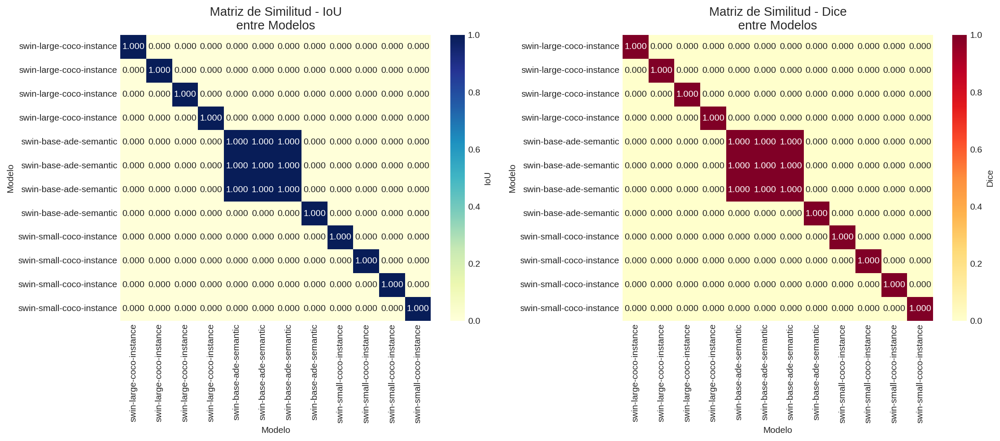

✅ Matriz de similitud guardada: /content/drive/MyDrive/TFM/mask2former/analisis_exports/graficas/matriz_similitud_modelos.png
✅ Matriz IoU exportada: /content/drive/MyDrive/TFM/mask2former/analisis_exports/tablas/matriz_iou_20251004_183054.csv
✅ Matriz Dice exportada: /content/drive/MyDrive/TFM/mask2former/analisis_exports/tablas/matriz_dice_20251004_183054.csv

--------------------------------------------------------------------------------
ANÁLISIS DE AGRUPAMIENTO DE MODELOS
--------------------------------------------------------------------------------



<Figure size 640x480 with 0 Axes>

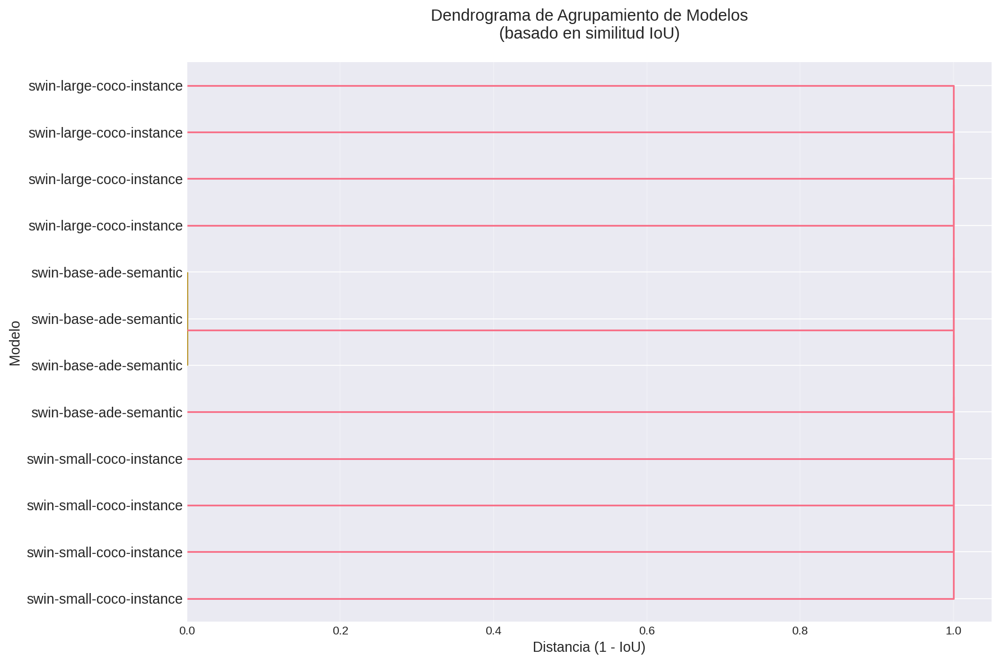

✅ Dendrograma guardado: /content/drive/MyDrive/TFM/mask2former/analisis_exports/graficas/dendrograma_modelos.png

--------------------------------------------------------------------------------
ANÁLISIS DE CONSENSO POR IMAGEN
--------------------------------------------------------------------------------

📊 TOP 10 IMÁGENES CON MAYOR CONSENSO:
Imagen  IoU_Promedio  IoU_Std  IoU_Min  IoU_Max Nivel_Consenso
 1.jpg         1.000    0.000    1.000    1.000           Alto
 2.jpg         1.000    0.000    1.000    1.000           Alto
 3.jpg         1.000    0.000    1.000    1.000           Alto
 5.jpg         1.000    0.000    1.000    1.000           Alto
 6.jpg         1.000    0.000    1.000    1.000           Alto
 7.jpg         1.000    0.000    1.000    1.000           Alto
 8.jpg         1.000    0.000    1.000    1.000           Alto
 9.jpg         1.000    0.000    1.000    1.000           Alto

📊 TOP 10 IMÁGENES CON MENOR CONSENSO (Mayor Desacuerdo):
Imagen  IoU_Promedio  IoU_St

<Figure size 640x480 with 0 Axes>

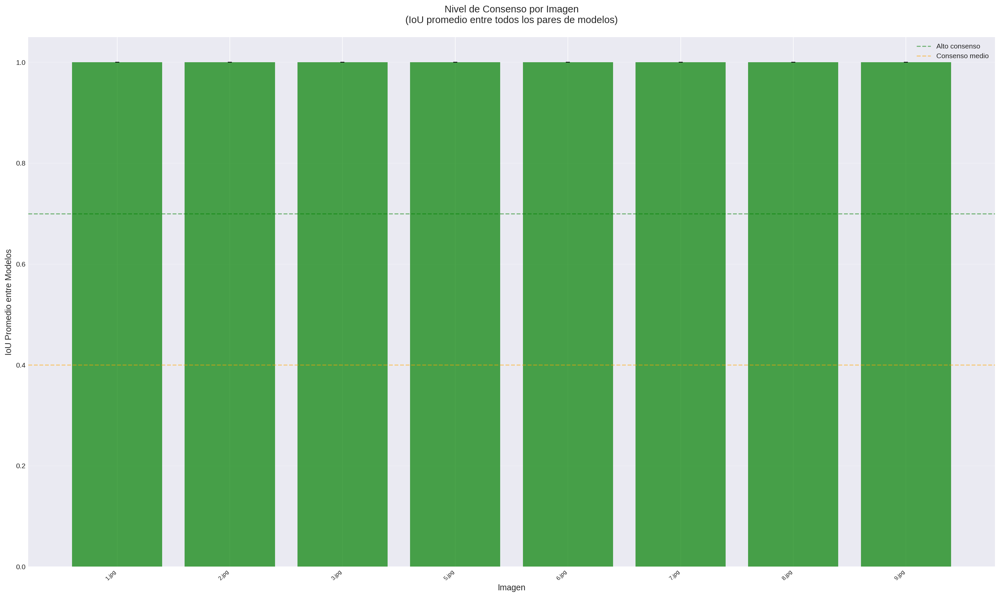


✅ Gráfica de consenso guardada: /content/drive/MyDrive/TFM/mask2former/analisis_exports/graficas/consenso_por_imagen.png
✅ Tabla de consenso exportada: /content/drive/MyDrive/TFM/mask2former/analisis_exports/tablas/consenso_por_imagen_20251004_183058.csv

✅ CELDA 5 COMPLETADA



<Figure size 640x480 with 0 Axes>

In [18]:
# =============================================================================
# CELDA 5: ANÁLISIS DE CONSISTENCIA ENTRE TODOS LOS MODELOS
# =============================================================================

print("\n" + "="*80)
print("CELDA 5: ANÁLISIS DE CONSISTENCIA ENTRE TODOS LOS MODELOS")
print("="*80 + "\n")

if len(resultados_sel) >= 2:
    print(f"🔍 Analizando consistencia entre {len(resultados_sel)} modelos\n")

    umbral_analisis = 'umbral_0.01'

    # Matriz de similitud entre modelos
    num_modelos = len(resultados_sel)
    modelos_nombres = [r['metadatos']['modelo_evaluado']['nombre_corto'] for r in resultados_sel]

    # Crear matriz de IoU promedio entre todos los pares de modelos
    matriz_iou = np.zeros((num_modelos, num_modelos))
    matriz_dice = np.zeros((num_modelos, num_modelos))

    print("📊 Calculando matriz de similitud entre modelos...")

    from tqdm import tqdm

    for i in range(num_modelos):
        for j in range(i, num_modelos):
            if i == j:
                matriz_iou[i, j] = 1.0
                matriz_dice[i, j] = 1.0
                continue

            # Comparar todas las imágenes entre modelo i y modelo j
            iou_list = []
            dice_list = []

            res_i = resultados_sel[i]
            res_j = resultados_sel[j]

            num_imgs = min(len(res_i['resultados_detallados']),
                          len(res_j['resultados_detallados']))

            for idx_img in range(num_imgs):
                res_img_i = res_i['resultados_detallados'][idx_img]
                res_img_j = res_j['resultados_detallados'][idx_img]

                # Cargar máscaras
                archivo_mask_i = res_img_i.get('mascaras', {}).get('archivo_mascaras')
                archivo_mask_j = res_img_j.get('mascaras', {}).get('archivo_mascaras')

                if not archivo_mask_i or not archivo_mask_j:
                    continue

                datos_mask_i = gestor_mascaras.cargar_mascaras_imagen(archivo_mask_i)
                datos_mask_j = gestor_mascaras.cargar_mascaras_imagen(archivo_mask_j)

                if not datos_mask_i or not datos_mask_j:
                    continue

                if umbral_analisis not in datos_mask_i['mascaras_por_umbral'] or \
                   umbral_analisis not in datos_mask_j['mascaras_por_umbral']:
                    continue

                masks_i_list = datos_mask_i['mascaras_por_umbral'][umbral_analisis]
                masks_j_list = datos_mask_j['mascaras_por_umbral'][umbral_analisis]

                # Combinar máscaras
                if len(masks_i_list) == 1:
                    mask_i = masks_i_list[0]
                else:
                    mask_i = np.maximum.reduce(masks_i_list)

                if len(masks_j_list) == 1:
                    mask_j = masks_j_list[0]
                else:
                    mask_j = np.maximum.reduce(masks_j_list)

                # Calcular métricas
                metricas = calcular_metricas_comparativas(mask_i, mask_j)
                iou_list.append(metricas['iou'])
                dice_list.append(metricas['dice'])

            # Promedio de IoU y Dice
            if iou_list:
                matriz_iou[i, j] = np.mean(iou_list)
                matriz_iou[j, i] = matriz_iou[i, j]
                matriz_dice[i, j] = np.mean(dice_list)
                matriz_dice[j, i] = matriz_dice[i, j]

    print("✅ Matriz de similitud calculada\n")

    # Visualizar matriz de IoU
    fig, axes = plt.subplots(1, 2, figsize=(16, 7), dpi=config.DPI)

    # Heatmap IoU
    sns.heatmap(matriz_iou, annot=True, fmt='.3f', cmap='YlGnBu',
                xticklabels=modelos_nombres, yticklabels=modelos_nombres,
                vmin=0, vmax=1, ax=axes[0], cbar_kws={'label': 'IoU'})
    axes[0].set_title('Matriz de Similitud - IoU\nentre Modelos', fontsize=14)
    axes[0].set_xlabel('Modelo')
    axes[0].set_ylabel('Modelo')

    # Heatmap Dice
    sns.heatmap(matriz_dice, annot=True, fmt='.3f', cmap='YlOrRd',
                xticklabels=modelos_nombres, yticklabels=modelos_nombres,
                vmin=0, vmax=1, ax=axes[1], cbar_kws={'label': 'Dice'})
    axes[1].set_title('Matriz de Similitud - Dice\nentre Modelos', fontsize=14)
    axes[1].set_xlabel('Modelo')
    axes[1].set_ylabel('Modelo')

    plt.tight_layout()
    plt.show()

    # Guardar
    fig_path = config.OUTPUT_PATH / "graficas" / f"matriz_similitud_modelos.png"
    plt.savefig(fig_path, dpi=config.DPI, bbox_inches='tight')
    print(f"✅ Matriz de similitud guardada: {fig_path}")

    # Exportar matrices
    df_iou_matrix = pd.DataFrame(matriz_iou, columns=modelos_nombres, index=modelos_nombres)
    df_dice_matrix = pd.DataFrame(matriz_dice, columns=modelos_nombres, index=modelos_nombres)

    if config.EXPORTAR_CSV:
        csv_iou_path = config.OUTPUT_PATH / "tablas" / f"matriz_iou_{datetime.now().strftime('%Y%m%d_%H%M%S')}.csv"
        csv_dice_path = config.OUTPUT_PATH / "tablas" / f"matriz_dice_{datetime.now().strftime('%Y%m%d_%H%M%S')}.csv"

        df_iou_matrix.to_csv(csv_iou_path)
        df_dice_matrix.to_csv(csv_dice_path)

        print(f"✅ Matriz IoU exportada: {csv_iou_path}")
        print(f"✅ Matriz Dice exportada: {csv_dice_path}")

    # Análisis de clustering de modelos basado en similitud
    print("\n" + "-"*80)
    print("ANÁLISIS DE AGRUPAMIENTO DE MODELOS")
    print("-"*80 + "\n")

    from scipy.cluster.hierarchy import dendrogram, linkage
    from scipy.spatial.distance import squareform

    # Convertir similitud (IoU) a distancia
    distancia_matrix = 1 - matriz_iou

    # Asegurar que la matriz es simétrica
    distancia_matrix = (distancia_matrix + distancia_matrix.T) / 2
    np.fill_diagonal(distancia_matrix, 0)

    # Linkage jerárquico
    condensed_dist = squareform(distancia_matrix)
    linkage_matrix = linkage(condensed_dist, method='average')

    # Dendrograma
    fig, ax = plt.subplots(figsize=(12, 8), dpi=config.DPI)

    dendrogram(linkage_matrix, labels=modelos_nombres, ax=ax,
              leaf_font_size=12, orientation='right')

    ax.set_title('Dendrograma de Agrupamiento de Modelos\n(basado en similitud IoU)',
                fontsize=14, pad=20)
    ax.set_xlabel('Distancia (1 - IoU)', fontsize=12)
    ax.set_ylabel('Modelo', fontsize=12)
    ax.grid(True, alpha=0.3, axis='x')

    plt.tight_layout()
    plt.show()

    # Guardar
    fig_path = config.OUTPUT_PATH / "graficas" / f"dendrograma_modelos.png"
    plt.savefig(fig_path, dpi=config.DPI, bbox_inches='tight')
    print(f"✅ Dendrograma guardado: {fig_path}")

    # Análisis de consenso: ¿Cuáles imágenes tienen mayor acuerdo entre modelos?
    print("\n" + "-"*80)
    print("ANÁLISIS DE CONSENSO POR IMAGEN")
    print("-"*80 + "\n")

    consenso_por_imagen = []

    num_imgs_analizar = len(resultados_sel[0]['resultados_detallados'])

    for idx_img in range(num_imgs_analizar):
        nombre_img = resultados_sel[0]['resultados_detallados'][idx_img]['imagen']['archivo']

        # Calcular IoU promedio entre todos los pares de modelos para esta imagen
        iou_pares = []

        for i in range(num_modelos):
            for j in range(i+1, num_modelos):
                res_i = resultados_sel[i]['resultados_detallados'][idx_img]
                res_j = resultados_sel[j]['resultados_detallados'][idx_img]

                archivo_mask_i = res_i.get('mascaras', {}).get('archivo_mascaras')
                archivo_mask_j = res_j.get('mascaras', {}).get('archivo_mascaras')

                if not archivo_mask_i or not archivo_mask_j:
                    continue

                datos_mask_i = gestor_mascaras.cargar_mascaras_imagen(archivo_mask_i)
                datos_mask_j = gestor_mascaras.cargar_mascaras_imagen(archivo_mask_j)

                if not datos_mask_i or not datos_mask_j:
                    continue

                if umbral_analisis not in datos_mask_i['mascaras_por_umbral'] or \
                   umbral_analisis not in datos_mask_j['mascaras_por_umbral']:
                    continue

                masks_i_list = datos_mask_i['mascaras_por_umbral'][umbral_analisis]
                masks_j_list = datos_mask_j['mascaras_por_umbral'][umbral_analisis]

                if len(masks_i_list) == 1:
                    mask_i = masks_i_list[0]
                else:
                    mask_i = np.maximum.reduce(masks_i_list)

                if len(masks_j_list) == 1:
                    mask_j = masks_j_list[0]
                else:
                    mask_j = np.maximum.reduce(masks_j_list)

                metricas = calcular_metricas_comparativas(mask_i, mask_j)
                iou_pares.append(metricas['iou'])

        if iou_pares:
            consenso_por_imagen.append({
                'Imagen': nombre_img,
                'IoU_Promedio': np.mean(iou_pares),
                'IoU_Std': np.std(iou_pares),
                'IoU_Min': np.min(iou_pares),
                'IoU_Max': np.max(iou_pares),
                'Nivel_Consenso': 'Alto' if np.mean(iou_pares) > 0.7 else 'Medio' if np.mean(iou_pares) > 0.4 else 'Bajo'
            })

    df_consenso = pd.DataFrame(consenso_por_imagen)

    if not df_consenso.empty:
        # Ordenar por IoU promedio
        df_consenso = df_consenso.sort_values('IoU_Promedio', ascending=False)

        print("📊 TOP 10 IMÁGENES CON MAYOR CONSENSO:")
        print(df_consenso.head(10).to_string(index=False))

        print("\n📊 TOP 10 IMÁGENES CON MENOR CONSENSO (Mayor Desacuerdo):")
        print(df_consenso.tail(10).to_string(index=False))

        # Gráfica de consenso
        fig, ax = plt.subplots(figsize=config.FIGSIZE_GRANDE, dpi=config.DPI)

        x = np.arange(len(df_consenso))
        colors = ['green' if nivel == 'Alto' else 'orange' if nivel == 'Medio' else 'red'
                 for nivel in df_consenso['Nivel_Consenso']]

        ax.bar(x, df_consenso['IoU_Promedio'], color=colors, alpha=0.7,
              yerr=df_consenso['IoU_Std'], capsize=3)

        ax.set_xlabel('Imagen', fontsize=12)
        ax.set_ylabel('IoU Promedio entre Modelos', fontsize=12)
        ax.set_title('Nivel de Consenso por Imagen\n(IoU promedio entre todos los pares de modelos)',
                    fontsize=14, pad=20)
        ax.set_xticks(x[::max(1, len(x)//20)])  # Mostrar cada 20 imágenes
        ax.set_xticklabels(df_consenso['Imagen'].iloc[::max(1, len(x)//20)],
                          rotation=45, ha='right', fontsize=8)
        ax.axhline(y=0.7, color='green', linestyle='--', alpha=0.5, label='Alto consenso')
        ax.axhline(y=0.4, color='orange', linestyle='--', alpha=0.5, label='Consenso medio')
        ax.legend()
        ax.grid(True, alpha=0.3, axis='y')

        plt.tight_layout()
        plt.show()

        # Guardar
        fig_path = config.OUTPUT_PATH / "graficas" / f"consenso_por_imagen.png"
        plt.savefig(fig_path, dpi=config.DPI, bbox_inches='tight')
        print(f"\n✅ Gráfica de consenso guardada: {fig_path}")

        # Exportar tabla de consenso
        if config.EXPORTAR_CSV:
            csv_path = config.OUTPUT_PATH / "tablas" / f"consenso_por_imagen_{datetime.now().strftime('%Y%m%d_%H%M%S')}.csv"
            df_consenso.to_csv(csv_path, index=False)
            print(f"✅ Tabla de consenso exportada: {csv_path}")

else:
    print("⚠️ Se necesitan al menos 2 modelos para análisis de consistencia")

print("\n✅ CELDA 5 COMPLETADA\n")


In [19]:
# =============================================================================
# RESUMEN FINAL Y CONCLUSIONES
# =============================================================================

print("\n" + "="*80)
print("RESUMEN FINAL DEL ANÁLISIS")
print("="*80 + "\n")

print("✅ ANÁLISIS COMPLETADO EXITOSAMENTE\n")

print("📊 RESULTADOS GENERADOS:")
print("=" * 80)

# Contar archivos generados
graficas_generadas = list(config.OUTPUT_PATH.glob("graficas/*.png"))
tablas_generadas = list(config.OUTPUT_PATH.glob("tablas/*.*"))
html_generados = list(config.OUTPUT_PATH.glob("html_interactivo/*.html"))

print(f"Gráficas PNG: {len(graficas_generadas)}")
for grafica in graficas_generadas:
    print(f"  - {grafica.name}")

print(f"\nTablas exportadas: {len(tablas_generadas)}")
for tabla in tablas_generadas:
    print(f"  - {tabla.name}")

if html_generados:
    print(f"\nGráficas interactivas HTML: {len(html_generados)}")
    for html in html_generados:
        print(f"  - {html.name}")


RESUMEN FINAL DEL ANÁLISIS

✅ ANÁLISIS COMPLETADO EXITOSAMENTE

📊 RESULTADOS GENERADOS:
Gráficas PNG: 20
  - heatmap_caracteristicas.png
  - shapely_img1_20251004_181745.png
  - shapely_img2_20251004_181758.png
  - shapely_img3_20251004_181805.png
  - shapely_img4_20251004_181825.png
  - shapely_img5_20251004_181838.png
  - shapely_img1_20251004_181945.png
  - shapely_img2_20251004_181956.png
  - shapely_img3_20251004_182003.png
  - shapely_img4_20251004_182015.png
  - shapely_img5_20251004_182027.png
  - mascaras_raw_img1_20251004_182151.png
  - mascaras_raw_img2_20251004_182208.png
  - mascaras_raw_img3_20251004_182218.png
  - mascaras_raw_img1_20251004_182353.png
  - mascaras_raw_img2_20251004_182410.png
  - mascaras_raw_img3_20251004_182419.png
  - matriz_similitud_modelos.png
  - dendrograma_modelos.png
  - consenso_por_imagen.png

Tablas exportadas: 10
  - comparativa_modelos_20251004_181244.csv
  - comparativa_modelos_20251004_181244.xlsx
  - comparativa_modelos_20251004_181245